In [20]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nibabel as nib
import statsmodels.formula.api as smf
from scipy import stats

plt.style.use('seaborn-v0_8-poster')


In [21]:
def significance_marker(p):
    if p < 0.001:
        return "***"
    elif p < 0.01:
        return "**"
    elif p < 0.05:
        return "*"
    else:
        return ""


def _draw_sig_line(ax, x1, x2, y, text, h=0.03):
    """Draw a flipped (downward) significance bracket below bars."""
    ax.plot((x1, x1, x2, x2),
            (y, y - h, y - h, y),
            lw=1.5, color="black", clip_on=False)
    if text:
        ax.text((x1 + x2) / 2.0, y - h * 1.2, text,
                ha="center", va="top",
                fontsize=14, fontweight="bold", color="black")


def get_matching_model_terms(model, variable):
    """
    Return model term names from model.params.index that match `variable`.

    Behavior:
    ----------
    - If `variable` has no ':' or '*' → return only main-effect terms
      (e.g., 'Group' → ['Group[T.HC]'])
    - If `variable` includes ':' or '*' → return exact interaction terms
      (e.g., 'Group:Drug' → ['Group[T.HC]:Drug[T.Placebo]'])
    - If `variable` == 'two_way' → return *all* 2-way interactions
      (useful in 3-factor models like Group * Drug * Gender)
    - If `variable` == 'three_way' → return *all* 3-way interactions

    Example model.params.index:
      ['Intercept',
       'Group[T.HC]',
       'Drug[T.Placebo]',
       'Gender[T.Female]',
       'Group[T.HC]:Drug[T.Placebo]',
       'Group[T.HC]:Gender[T.Female]',
       'Drug[T.Placebo]:Gender[T.Female]',
       'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]']
    """
    # Remove intercept
    params = [p for p in model.params.index if p.lower() != "intercept"]

    # === Case 1: Request all 2-way interactions ===
    if variable.lower() == "two_way":
        return [p for p in params if p.count(":") == 1]

    # === Case 2: Request all 3-way interactions ===
    if variable.lower() == "three_way":
        return [p for p in params if p.count(":") == 2]

    # === Case 3: Single factor → main effects only ===
    if (":" not in variable) and ("*" not in variable):
        factor = variable
        return [p for p in params if p.startswith(factor + "[") and (":" not in p)]

    # === Case 4: Specific interaction (2-way or 3-way) ===
    var = variable.replace("*", ":")
    factors = [f for f in var.split(":") if f]

    out = []
    for p in params:
        # must have correct interaction order
        if p.count(":") != (len(factors) - 1):
            continue
        # must include all specified factors
        if all((f + "[") in p for f in factors):
            out.append(p)

    return out



def extract_factors_from_term(term):
    """
    Extract base factor names (e.g., 'Group', 'Drug', 'Gender') 
    from a statsmodels term like:
        'Group[T.HC]:Drug[T.Placebo]'  → ['Group', 'Drug']
        'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]' → ['Group', 'Drug', 'Gender']
        'Group[T.HC]' → ['Group']

    Works for both main and interaction terms.
    """
    # Split by ':' to separate interaction components
    parts = term.split(":")
    # For each part, take everything before the first '['
    factors = [p.split("[")[0] for p in parts]
    return factors

In [22]:
def add_sig_stars(ax, df, roi_list, variable, pad_frac=0.1, hue_order=None):
    """
    Generalized version that supports 2-way, 3-way, or higher-order interactions.

    Prints:
      1. Model result (ROI, variable, β, t, df, p)
      2. One-sample t-tests (ROI, factor level, mean, t, df, p)
    Adds * to bar plot for significant results.

    Automatically reads model factors from 'variable'.
    e.g. variable='Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]' → model='Z_score ~ Group * Drug * Gender'
    """

    ymin, ymax = ax.get_ylim()
    y_range = ymax - ymin
    is_interaction = ":" in variable

    # === Parse model factors dynamically ===
    # Example: 'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]' → ['Group', 'Drug', 'Gender']
    factors = list(dict.fromkeys([term.split("[")[0] for term in variable.split(":")]))
    formula = "Z_score ~ " + " * ".join(factors) + ("" if "guess" in factors else " + guess")


    print(f"\nModel results ({formula})")
    print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
    print("-" * 100)

    # === Table 1: Model results ===
    for i, roi in enumerate(roi_list):
        df_roi = df[df["ROI"] == roi]
        if len(df_roi) < 4:
            continue

        # 🔹 Dynamically specified model
        model = smf.ols(formula, data=df_roi).fit()

        if variable not in model.params.index:
            continue

        beta = model.params[variable]
        tval = model.tvalues[variable]
        pval = model.pvalues[variable]
        dfree = int(model.df_resid)
        star = significance_marker(pval)

        print(f"{roi:<15} {variable:<50} {beta:>10.3f} {tval:>8.2f} {dfree:>5} {pval:>8.3f} {star:>5}")

        # --- Bar selection per ROI ---
        bars = [r for r in ax.patches if abs((r.get_x() + r.get_width() / 2) - i) < 0.45]
        if not bars:
            continue

        # --- Draw flipped bracket for significant model effects (main effects only) ---
        if not is_interaction and star:
            bars_sorted = sorted(bars, key=lambda r: r.get_x())
            b1, b2 = bars_sorted[0], bars_sorted[-1]
            x1c = b1.get_x() + b1.get_width() / 2
            x2c = b2.get_x() + b2.get_width() / 2
            x_mid = (x1c + x2c) / 2
            y1 = b1.get_y() + b1.get_height()
            y2 = b2.get_y() + b2.get_height()
            min_y = min(y1, y2)
            y_bracket = min_y - 0.3
            y_star = min_y - 0.4
            _draw_sig_line(ax, x1c, x2c, y_bracket, "", h=y_range * 0.03)
            ax.text(x_mid, y_star, star,
                    ha="center", va="top",
                    fontsize=14, fontweight="bold", color="black")

    print("-" * 100)

    # === Table 2: One-sample t-tests ===
    if is_interaction:
        group_factors = factors
        print(f"ONE-SAMPLE T-TESTS BY INTERACTION LEVEL ({' × '.join(group_factors)})")
    else:
        group_factors = [factors[0]]
        print(f"ONE-SAMPLE T-TESTS BY {group_factors[0].upper()} LEVEL")

    print(f"{'ROI':<15} {'Level':<50} {'Mean':>10} {'t':>8} {'df':>6} {'p':>10} {'Sig':>5}")
    print("-" * 100)

    for i, roi in enumerate(roi_list):
        df_roi = df[df["ROI"] == roi]
        if len(df_roi) < 4:
            continue

        bars = [r for r in ax.patches if abs((r.get_x() + r.get_width() / 2) - i) < 0.45]

        # === Main effect ===
        if len(group_factors) == 1:
            factor = group_factors[0]
            if factor not in df_roi.columns:
                continue

            for level, vals in df_roi.groupby(factor, observed=False):
                if len(vals) < 3:
                    continue
                tstat, pval = stats.ttest_1samp(vals["Z_score"], 0)
                dfree = len(vals) - 1
                mean_val = np.mean(vals["Z_score"])
                star = significance_marker(pval)
                label = f"{factor}={level}"
                print(f"{roi:<15} {label:<50} {mean_val:>10.3f} {tstat:>8.2f} {dfree:>6} {pval:>10.3f} {star:>5}")

                if star:
                    if hue_order is None:
                        hue_order = list(df[factor].cat.categories)
                    level_to_bar = dict(zip(hue_order, bars))
                    if level in level_to_bar:
                        rect = level_to_bar[level]
                        cx = rect.get_x() + rect.get_width() / 2
                        top = rect.get_y() + rect.get_height()
                        y_star = 0.04 if mean_val <= 0 else top + y_range * pad_frac + 0.2
                        ax.text(cx, y_star, star,
                                ha="center", va="bottom",
                                fontsize=14, fontweight="bold", color="black")

        # === Interaction effect (2-way, 3-way, or higher) ===
        else:
            valid_factors = [f for f in group_factors if f in df_roi.columns]
            if len(valid_factors) < 2:
                continue

            for levels, vals in df_roi.groupby(valid_factors, observed=False):
                if len(vals) < 3:
                    continue
                tstat, pval = stats.ttest_1samp(vals["Z_score"], 0)
                dfree = len(vals) - 1
                mean_val = np.mean(vals["Z_score"])
                star = significance_marker(pval)
                level_labels = "_".join(map(str, levels))
                print(f"{roi:<15} {level_labels:<50} {mean_val:>10.3f} "
                      f"{tstat:>8.2f} {dfree:>6} {pval:>10.3f} {star:>5}")

                if star:
                    # Build hue order dynamically based on unique combinations
                    if hue_order is None:
                        hue_order = [
                            "_".join(map(str, combo))
                            for combo in df_roi[valid_factors]
                            .drop_duplicates()
                            .itertuples(index=False, name=None)
                        ]
                    level_to_bar = dict(zip(hue_order, bars))
                    key = "_".join(map(str, levels))
                    if key in level_to_bar:
                        rect = level_to_bar[key]
                        cx = rect.get_x() + rect.get_width() / 2
                        top = rect.get_y() + rect.get_height()
                        y_star = 0.04 if mean_val <= 0 else top + y_range * pad_frac + 0.2
                        ax.text(cx, y_star, star,
                                ha="center", va="bottom",
                                fontsize=14, fontweight="bold", color="black")

    print("-" * 100)


In [23]:
def add_sig_stars_lineplot_interaction(ax, df, roi_list, variable):
    """
    Adds significance stars (***, **, *) to each subplot's title
    if the specified interaction term in `variable` is significant
    for that ROI.

    Automatically supports 2-way, 3-way, or higher-order interactions.
    e.g.:
        'Group[T.HC]:Gender[T.Female]'
        'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]'
    """

    # Extract main factors from variable (remove duplicates safely)
    factors = list(dict.fromkeys([term.split("[")[0] for term in variable.split(":")]))
    formula = "Z_score ~ " + " * ".join(factors) + ("" if "guess" in factors else " + guess")


    axes = ax.flat if hasattr(ax, "flat") else [ax]

    print(f"\n=== Lineplot significance check for {variable} ===")
    print(f"Model formula: {formula}")
    print(f"{'ROI':<15} {'p-value':>10} {'Sig':>5}")
    print("-" * 35)

    for i, roi in enumerate(roi_list):
        if i >= len(axes):
            break
        ax_i = axes[i]

        df_roi = df[df["ROI"] == roi]
        if len(df_roi) < 4:
            continue

        # Dynamically fit model with all relevant factors
        model = smf.ols(formula, data=df_roi).fit()

        # Skip if the term is not part of the model
        if variable not in model.pvalues.index:
            continue

        # Get p-value and significance marker
        pval = model.pvalues[variable]
        star = significance_marker(pval)

        # Update subplot title with star if significant
        current_title = ax_i.get_title()
        new_title = f"{current_title} {star}" if star else current_title
        ax_i.set_title(new_title, fontweight="bold" if star else "normal")

        print(f"{roi:<15} {pval:>10.4f} {star:>5}")

    print("-" * 35)


In [24]:
tasks = ['phase2','phase3']
contrast_list = [
        "CSR-CSS",   
        "CSR-CS-",
        "CSS-CS-",
        "CSR-fix", 
        "CSS-fix",   
        "CSminus-fix"
        ]
ROI_list = [
        'Amygdala', 'Insula', 'Hippocampus', 'ACC', 
        'VMPFC'
        ]
group_list = [
        'Patient',
        'HC'
        ]
drug_list = ['Oxytocin',
        'Placebo']
gender_list = ['Male', 'Female']

In [25]:
plot_dir_top = '/Users/xiaoqianxiao/Projects/NARSAD/MRI/derivatives/fMRI_analysis/ROI/plots/model-guess_motion-removeFD0.5'
drug_order_file = '/Users/xiaoqianxiao/Projects/NARSAD/MRI/source_data/behav/drug_order.xlsx'
df_drug_order = pd.read_excel(drug_order_file, 'drug_order')
first_level_dir = '/Users/xiaoqianxiao/Projects/NARSAD/MRI/derivatives/fMRI_analysis/ROI'
first_level_data_file = os.path.join(first_level_dir, 'first_level_motion-removeFD0.5.csv')
df_fMRI = pd.read_csv(first_level_data_file)
df_merged = pd.merge(df_fMRI, df_drug_order, on='subID', how='left')
df_all = df_merged.rename(columns={
    'Task': 'Phase'
})
df_all.loc[df_all['subID'].str.startswith('N1'), 'Group'] = 'Patient'
df_all.loc[df_all['subID'].str.startswith('N2'), 'Group'] = 'HC'
categorical_cols = ['ROI', 'subID', 'Phase', 'Contrast', 'Group', 'Gender', 'Drug','guess']
df_all[categorical_cols] = df_all[categorical_cols].astype('category')
df_all['Contrast'] = df_all['Contrast'].cat.set_categories(contrast_list, ordered=True)
df_all['ROI'] = df_all['ROI'].cat.set_categories(ROI_list, ordered=True)
df_all['Group'] = df_all['Group'].cat.set_categories(group_list, ordered=True)
df_all['Drug'] = df_all['Drug'].cat.set_categories(drug_list, ordered=True)
df_all['Gender'] = df_all['Gender'].cat.set_categories(gender_list, ordered=True)


In [26]:
print(len(df_fMRI.loc[df_fMRI['Task']=='phase2']['subID'].unique()))
print(len(df_fMRI.loc[df_fMRI['Task']=='phase3']['subID'].unique()))
print(len(df_drug_order['subID'].unique()))

100
101
104


In [27]:
# Subjects in drug order but missing from fMRI data
missing_in_fMRI = df_drug_order.loc[
    ~df_drug_order['subID'].isin(df_fMRI.loc[df_fMRI['Task']=='phase2']['subID']), 'subID'
].unique()

print(f"🧩 Subjects in drug order file but not in fMRI data in phase2: {len(missing_in_fMRI)}")
print(missing_in_fMRI)

missing_in_fMRI = df_drug_order.loc[
    ~df_drug_order['subID'].isin(df_fMRI.loc[df_fMRI['Task']=='phase3']['subID']), 'subID'
].unique()

print(f"🧩 Subjects in drug order file but not in fMRI data in phase3: {len(missing_in_fMRI)}")
print(missing_in_fMRI)
# SUBJECTS_NO_MRI = {
#     'phase2': ['N102', 'N208'],
#     'phase3': ['N102', 'N208', 'N120']
# }
# removing subjects w wrong sequence / missing phases:
# sub101 has 2mm seq for phase 2, 3mm (correct) for phase 3
# sub201, has 2mm seq for phase 2, 3mm (correct) for phase 3



🧩 Subjects in drug order file but not in fMRI data in phase2: 4
['N101' 'N102' 'N201' 'N208']
🧩 Subjects in drug order file but not in fMRI data in phase3: 3
['N102' 'N120' 'N208']


Extinction

Entire

In [28]:
plot_dir = os.path.join(plot_dir_top, 'extinction/entire_dataset')
os.makedirs(plot_dir, exist_ok=True)
model = smf.ols("Z_score ~ Group * Drug * Gender", data=df_all).fit()


===== Group main effect: CSR-CSS =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.245     1.08    97    0.284      
Insula          Group[T.HC]                                             0.120     0.49    97    0.625      
Hippocampus     Group[T.HC]                                             0.050     0.20    97    0.842      
ACC             Group[T.HC]                                             0.246     1.01    97    0.313      
VMPFC           Group[T.HC]                                            -0.135    -0.51    97    0.614      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

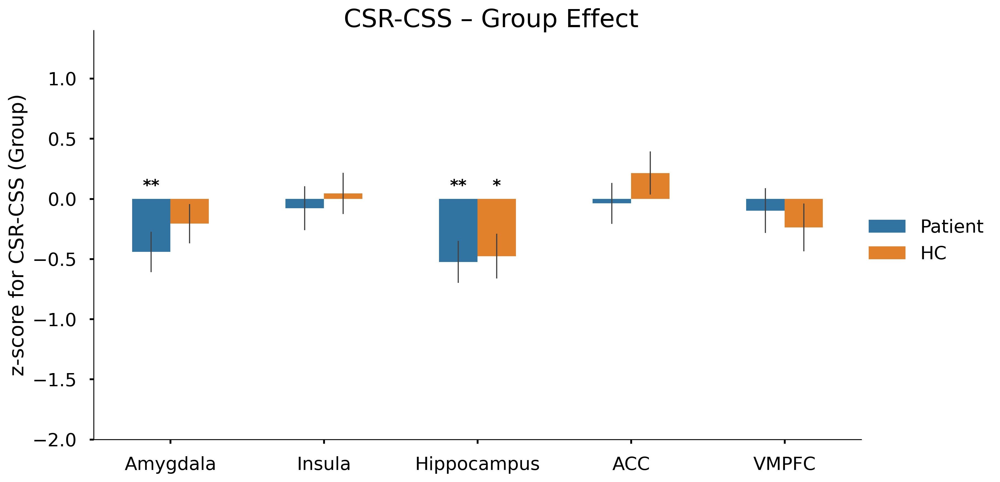


===== Group main effect: CSR-CS- =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.180     0.79    97    0.433      
Insula          Group[T.HC]                                             0.434     1.53    97    0.130      
Hippocampus     Group[T.HC]                                             0.130     0.44    97    0.662      
ACC             Group[T.HC]                                             0.371     1.27    97    0.208      
VMPFC           Group[T.HC]                                            -0.176    -0.58    97    0.566      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

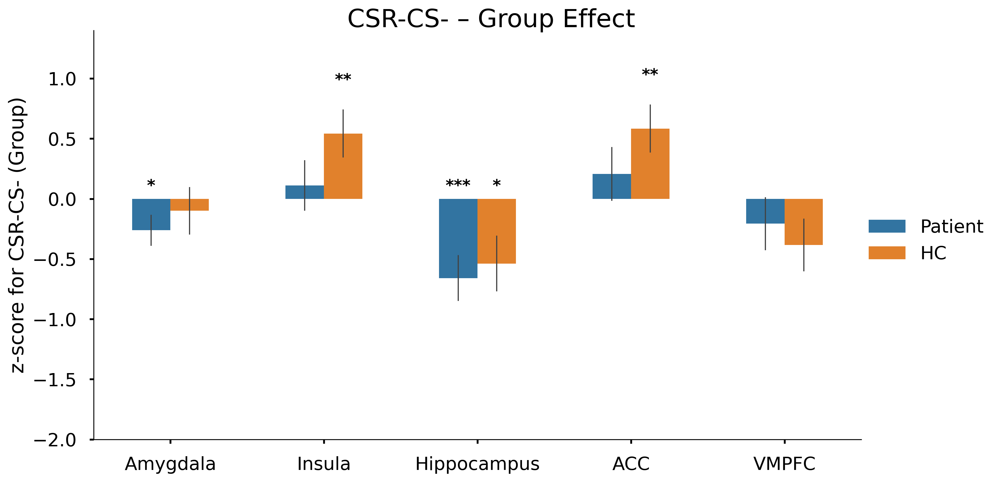


===== Group main effect: CSS-CS- =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.085    -0.39    97    0.694      
Insula          Group[T.HC]                                             0.298     1.09    97    0.280      
Hippocampus     Group[T.HC]                                             0.075     0.32    97    0.751      
ACC             Group[T.HC]                                             0.110     0.40    97    0.687      
VMPFC           Group[T.HC]                                            -0.022    -0.08    97    0.936      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

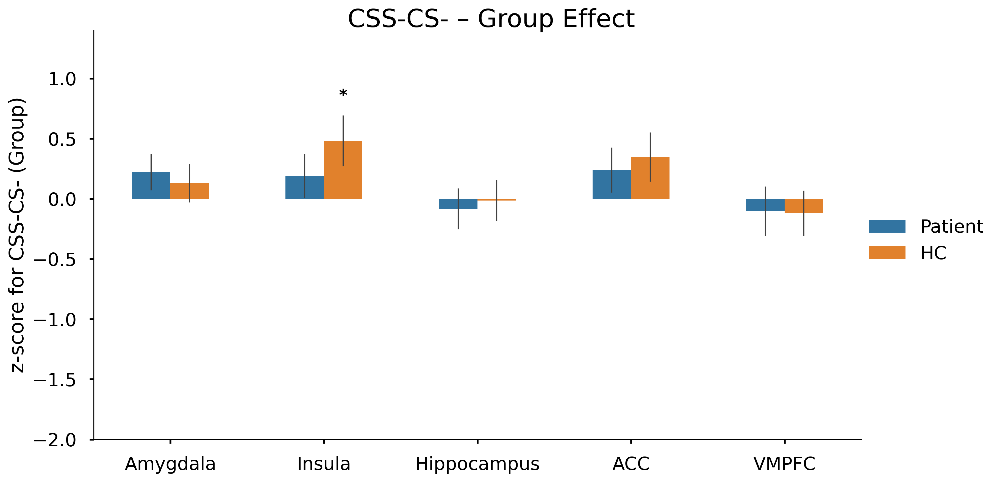


===== Group main effect: CSR-fix =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.159     0.64    97    0.523      
Insula          Group[T.HC]                                             0.450     1.89    97    0.062      
Hippocampus     Group[T.HC]                                             0.012     0.04    97    0.967      
ACC             Group[T.HC]                                             0.473     1.62    97    0.108      
VMPFC           Group[T.HC]                                            -0.033    -0.11    97    0.915      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

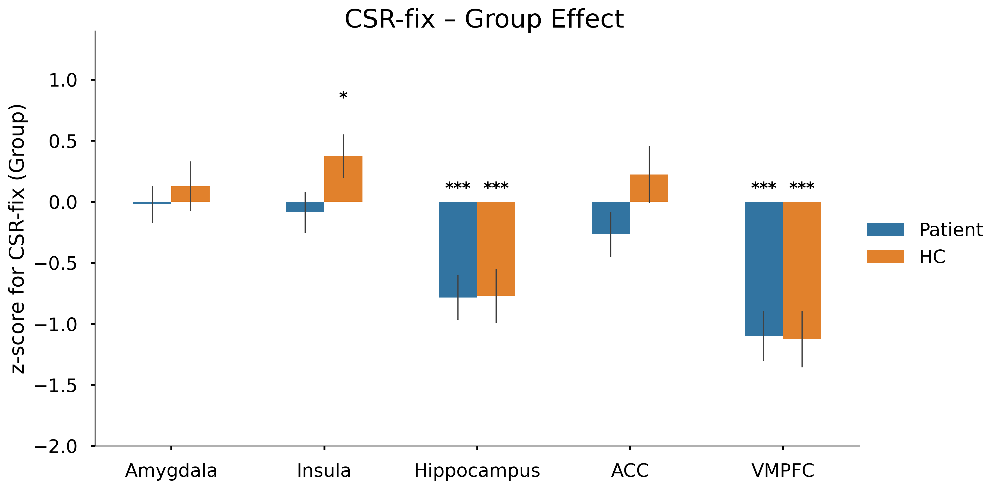


===== Group main effect: CSS-fix =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.174    -0.77    97    0.445      
Insula          Group[T.HC]                                             0.273     1.09    97    0.279      
Hippocampus     Group[T.HC]                                            -0.052    -0.23    97    0.821      
ACC             Group[T.HC]                                             0.120     0.46    97    0.648      
VMPFC           Group[T.HC]                                             0.137     0.49    97    0.622      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

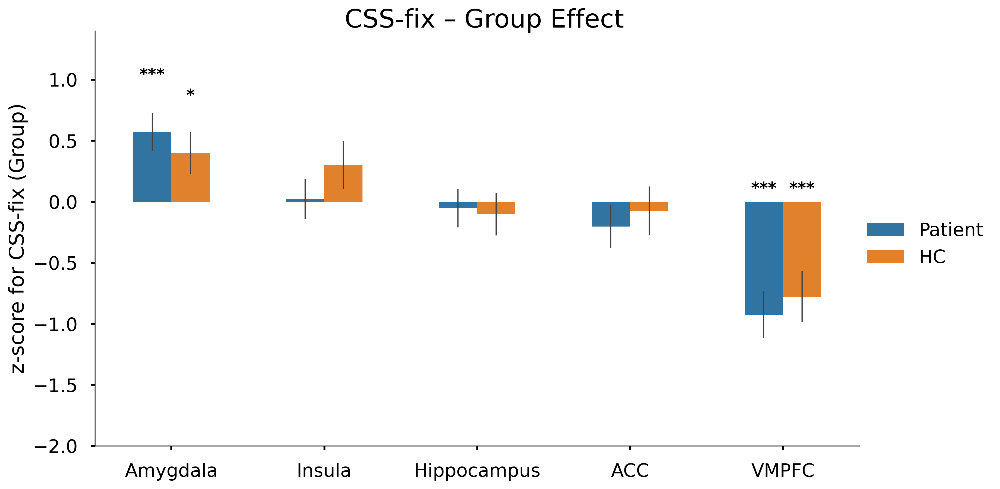


===== Group main effect: CSminus-fix =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.067    -0.29    97    0.772      
Insula          Group[T.HC]                                            -0.117    -0.40    97    0.691      
Hippocampus     Group[T.HC]                                            -0.169    -0.62    97    0.535      
ACC             Group[T.HC]                                            -0.013    -0.05    97    0.963      
VMPFC           Group[T.HC]                                             0.199     0.66    97    0.508      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level          

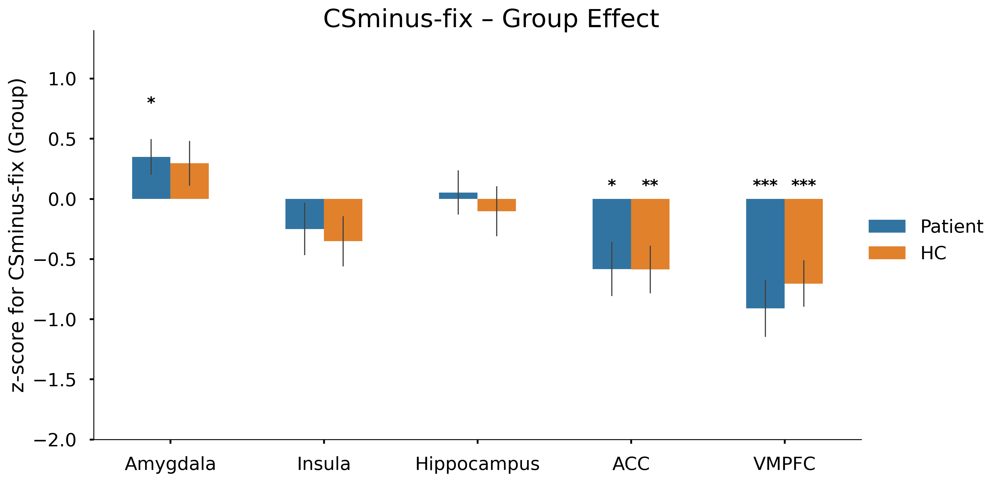

In [29]:
# 1️⃣ Group main effect
# ---------------------------------------------------------
for contrast in contrast_list:
    print(f"\n===== Group main effect: {contrast} =====")
    df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

    g = sns.catplot(
        x='ROI', y='Z_score', hue='Group',
        order=ROI_list, hue_order=group_list,
        kind='bar', errorbar='se', 
        height=6, aspect=1.8, width=0.5, 
        err_kws={'linewidth': 1},
        data=df
    )

    ax = g.ax
    add_sig_stars(ax, df, ROI_list, get_matching_model_terms(model, "Group")[0], hue_order=group_list)


    g.set_axis_labels('', f'z-score for {contrast} (Group)')
    g.set(ylim=(-2, 1.4))
    g.legend.set_title('')
    g.figure.suptitle(f'{contrast} – Group Effect', fontsize=22, y=1.02)
    g.figure.set_dpi(300)
    plt.savefig(f'{plot_dir}/{contrast}_Group_sig.png', bbox_inches='tight')
    plt.show()


===== Gender main effect: CSR-CSS =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.050    -0.21    97    0.834      
Insula          Drug[T.Placebo]                                        -0.386    -1.54    97    0.127      
Hippocampus     Drug[T.Placebo]                                         0.342     1.33    97    0.187      
ACC             Drug[T.Placebo]                                        -0.082    -0.32    97    0.746      
VMPFC           Drug[T.Placebo]                                        -0.170    -0.62    97    0.539      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

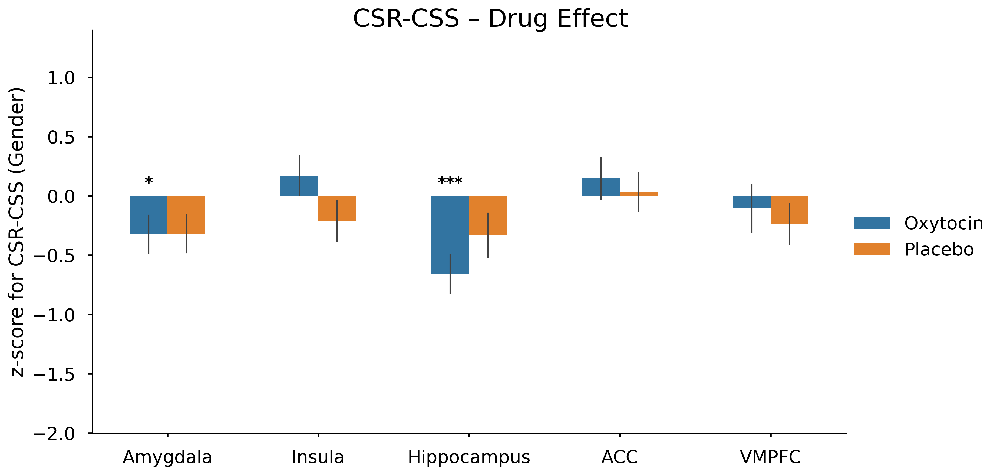


===== Gender main effect: CSR-CS- =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.239     1.01    97    0.313      
Insula          Drug[T.Placebo]                                        -0.340    -1.16    97    0.251      
Hippocampus     Drug[T.Placebo]                                         0.393     1.30    97    0.197      
ACC             Drug[T.Placebo]                                        -0.494    -1.64    97    0.104      
VMPFC           Drug[T.Placebo]                                        -0.205    -0.65    97    0.517      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

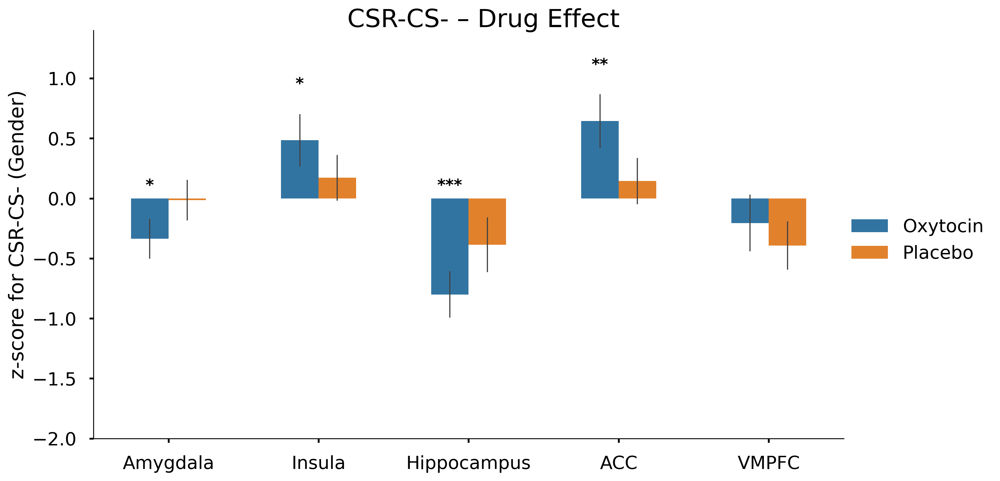


===== Gender main effect: CSS-CS- =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.280     1.27    97    0.206      
Insula          Drug[T.Placebo]                                         0.079     0.28    97    0.783      
Hippocampus     Drug[T.Placebo]                                         0.007     0.03    97    0.977      
ACC             Drug[T.Placebo]                                        -0.396    -1.42    97    0.159      
VMPFC           Drug[T.Placebo]                                        -0.041    -0.15    97    0.883      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

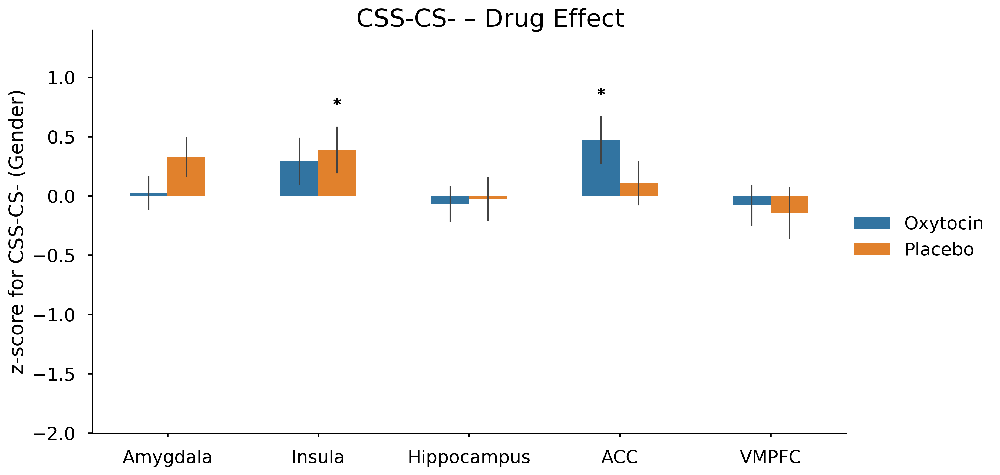


===== Gender main effect: CSR-fix =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.338     1.33    97    0.187      
Insula          Drug[T.Placebo]                                        -0.101    -0.40    97    0.687      
Hippocampus     Drug[T.Placebo]                                         0.461     1.59    97    0.114      
ACC             Drug[T.Placebo]                                         0.148     0.49    97    0.629      
VMPFC           Drug[T.Placebo]                                         0.062     0.20    97    0.844      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

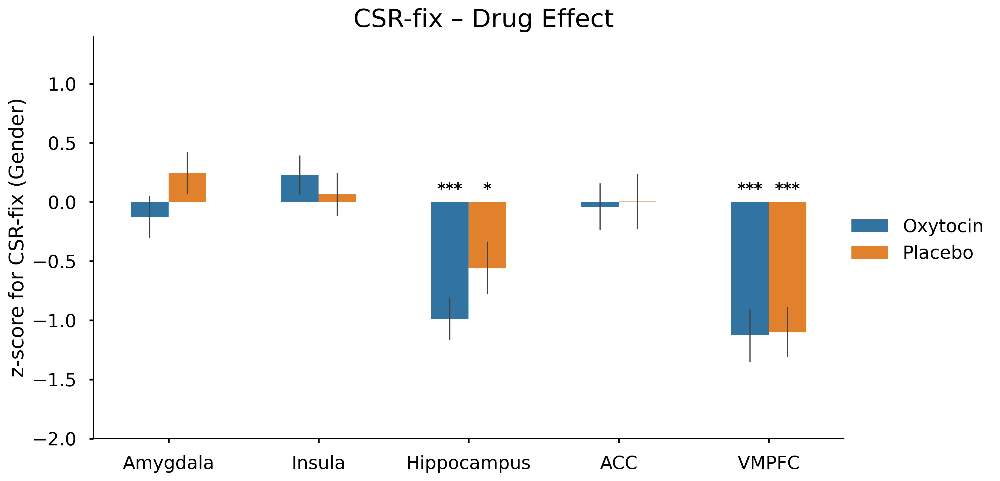


===== Gender main effect: CSS-fix =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.384     1.66    97    0.101      
Insula          Drug[T.Placebo]                                         0.431     1.68    97    0.096      
Hippocampus     Drug[T.Placebo]                                        -0.027    -0.12    97    0.908      
ACC             Drug[T.Placebo]                                         0.245     0.91    97    0.366      
VMPFC           Drug[T.Placebo]                                         0.268     0.94    97    0.350      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

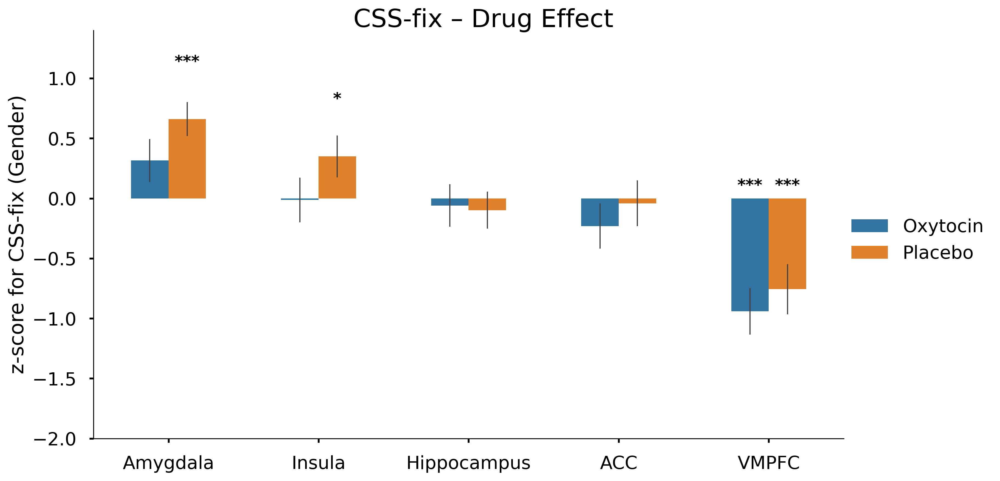


===== Gender main effect: CSminus-fix =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.052     0.22    97    0.827      
Insula          Drug[T.Placebo]                                         0.376     1.24    97    0.217      
Hippocampus     Drug[T.Placebo]                                        -0.043    -0.15    97    0.879      
ACC             Drug[T.Placebo]                                         0.855     2.95    97    0.004    **
VMPFC           Drug[T.Placebo]                                         0.351     1.14    97    0.258      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level           

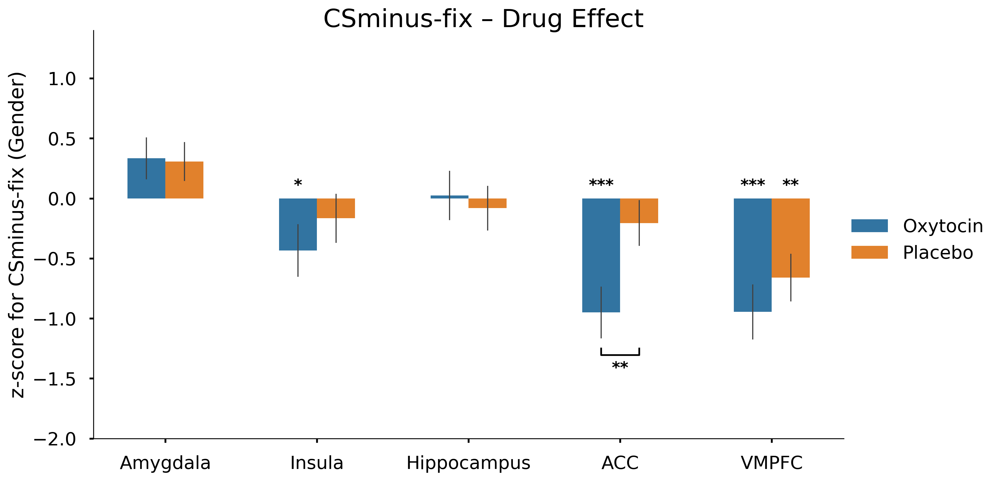

In [30]:
# ---------------------------------------------------------
# 3️⃣ Drug main effect
# ---------------------------------------------------------
for contrast in contrast_list:
    print(f"\n===== Gender main effect: {contrast} =====")
    df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

    g = sns.catplot(
        x='ROI', y='Z_score', hue='Drug',
        order=ROI_list, kind='bar', errorbar='se', height=6, aspect=1.8, width=0.5, 
        err_kws={'linewidth': 1},
        data=df
    )

    ax = g.ax
    add_sig_stars(ax, df, ROI_list, get_matching_model_terms(model, "Drug")[0])

    g.set_axis_labels('', f'z-score for {contrast} (Gender)')
    g.set(ylim=(-2, 1.4))
    g.legend.set_title('')
    g.figure.suptitle(f'{contrast} – Drug Effect', fontsize=22, y=1.02)
    g.figure.set_dpi(300)
    plt.savefig(f'{plot_dir}/{contrast}_Drug_sig.png', bbox_inches='tight')
    plt.show()


===== Gender main effect: CSR-CSS =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.317     1.40    97    0.166      
Insula          Gender[T.Female]                                       -0.348    -1.42    97    0.157      
Hippocampus     Gender[T.Female]                                        0.194     0.77    97    0.443      
ACC             Gender[T.Female]                                       -0.094    -0.38    97    0.702      
VMPFC           Gender[T.Female]                                        0.198     0.74    97    0.464      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

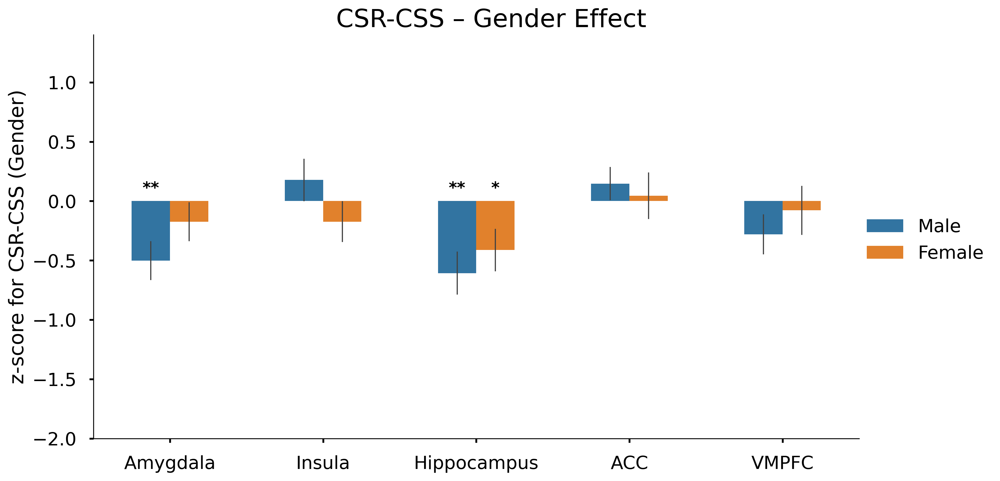


===== Gender main effect: CSR-CS- =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.328     1.44    97    0.154      
Insula          Gender[T.Female]                                       -0.043    -0.15    97    0.882      
Hippocampus     Gender[T.Female]                                        0.011     0.04    97    0.970      
ACC             Gender[T.Female]                                       -0.260    -0.88    97    0.382      
VMPFC           Gender[T.Female]                                       -0.040    -0.13    97    0.897      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

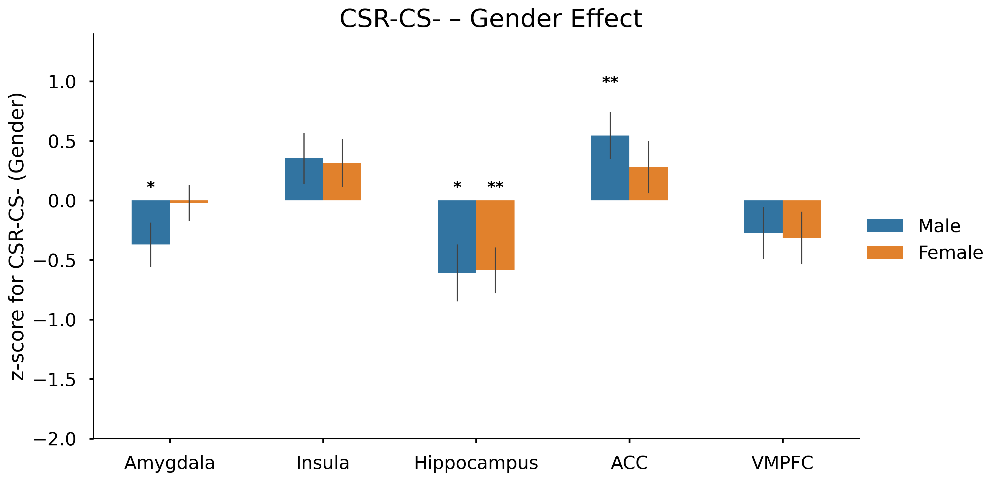


===== Gender main effect: CSS-CS- =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                       -0.031    -0.14    97    0.887      
Insula          Gender[T.Female]                                        0.323     1.17    97    0.245      
Hippocampus     Gender[T.Female]                                       -0.214    -0.91    97    0.366      
ACC             Gender[T.Female]                                       -0.163    -0.59    97    0.555      
VMPFC           Gender[T.Female]                                       -0.258    -0.95    97    0.346      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

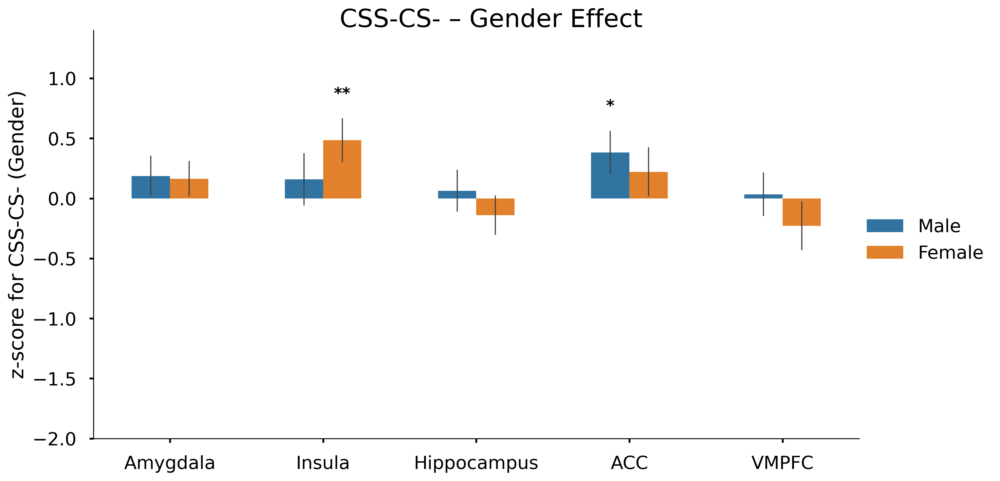


===== Gender main effect: CSR-fix =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.512     2.09    97    0.039     *
Insula          Gender[T.Female]                                       -0.276    -1.14    97    0.257      
Hippocampus     Gender[T.Female]                                        0.318     1.13    97    0.263      
ACC             Gender[T.Female]                                       -0.607    -2.08    97    0.040     *
VMPFC           Gender[T.Female]                                        0.060     0.20    97    0.846      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

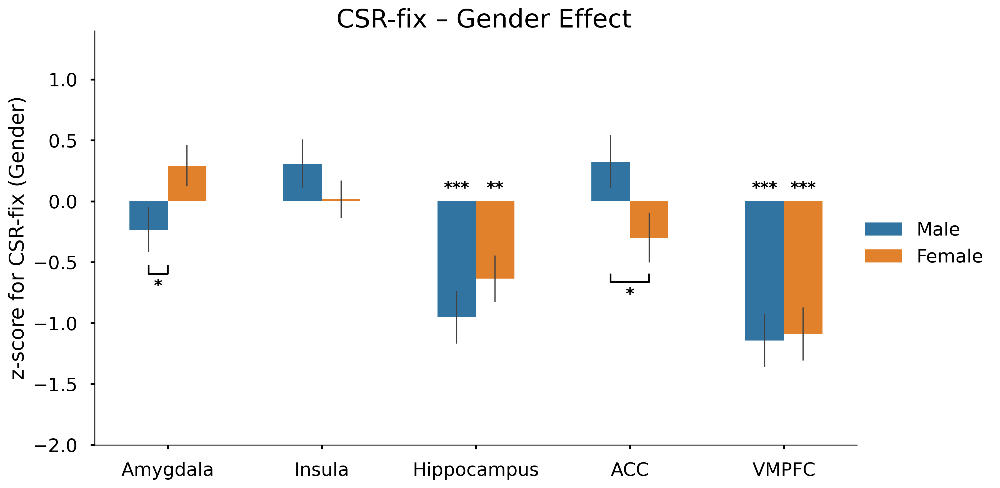


===== Gender main effect: CSS-fix =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.067     0.29    97    0.771      
Insula          Gender[T.Female]                                        0.198     0.78    97    0.436      
Hippocampus     Gender[T.Female]                                        0.048     0.21    97    0.836      
ACC             Gender[T.Female]                                       -0.469    -1.81    97    0.074      
VMPFC           Gender[T.Female]                                       -0.220    -0.79    97    0.431      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

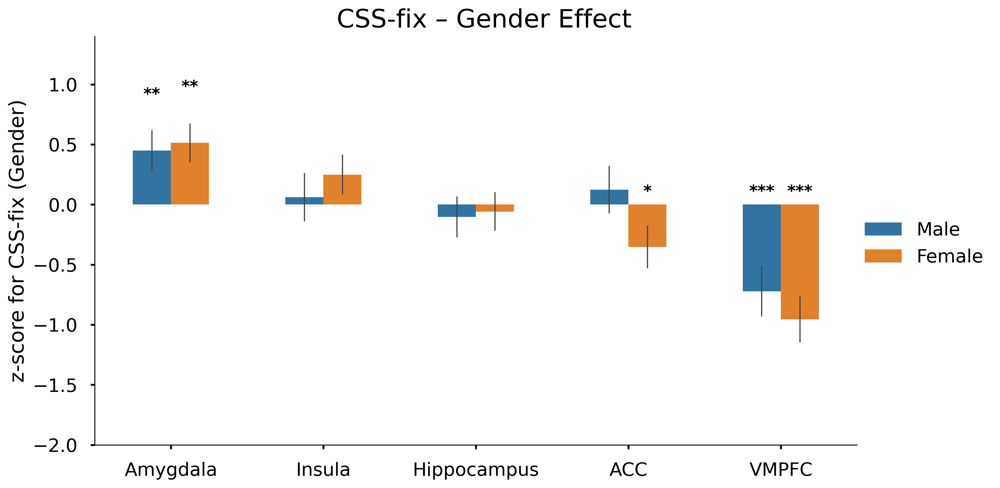


===== Gender main effect: CSminus-fix =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.106     0.46    97    0.650      
Insula          Gender[T.Female]                                       -0.250    -0.85    97    0.400      
Hippocampus     Gender[T.Female]                                        0.340     1.25    97    0.214      
ACC             Gender[T.Female]                                       -0.304    -1.04    97    0.303      
VMPFC           Gender[T.Female]                                        0.134     0.44    97    0.659      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level       

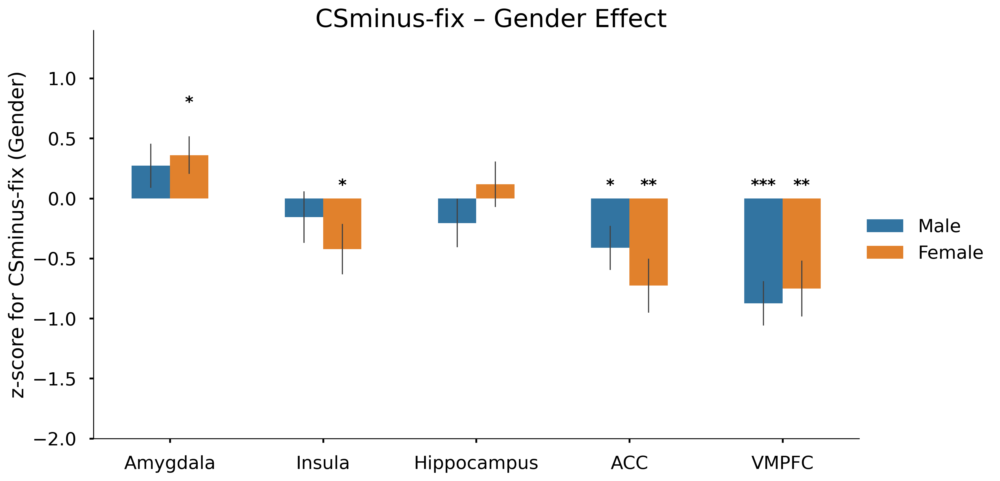

In [31]:
# ---------------------------------------------------------
# 3️⃣ Gender main effect
# ---------------------------------------------------------
for contrast in contrast_list:
    print(f"\n===== Gender main effect: {contrast} =====")
    df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

    g = sns.catplot(
        x='ROI', y='Z_score', hue='Gender',
        order=ROI_list, kind='bar', errorbar='se', height=6, aspect=1.8, width=0.5, 
        err_kws={'linewidth': 1},
        data=df
    )

    ax = g.ax
    add_sig_stars(ax, df, ROI_list, get_matching_model_terms(model, "Gender")[0])

    g.set_axis_labels('', f'z-score for {contrast} (Gender)')
    g.set(ylim=(-2, 1.4))
    g.legend.set_title('')
    g.figure.suptitle(f'{contrast} – Gender Effect', fontsize=22, y=1.02)
    g.figure.set_dpi(300)
    plt.savefig(f'{plot_dir}/{contrast}_Gender_sig.png', bbox_inches='tight')
    plt.show()

In [32]:
get_matching_model_terms(model, "two_way")

['Group[T.HC]:Drug[T.Placebo]',
 'Group[T.HC]:Gender[T.Female]',
 'Drug[T.Placebo]:Gender[T.Female]']


===== Group × Drug interaction: CSR-CSS =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.479     1.04    95    0.301      
Insula          Group[T.HC]:Drug[T.Placebo]                             0.603     1.23    95    0.222      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                             0.624     1.24    95    0.219      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.077     0.16    95    0.877      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.156     0.29    95    0.775      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


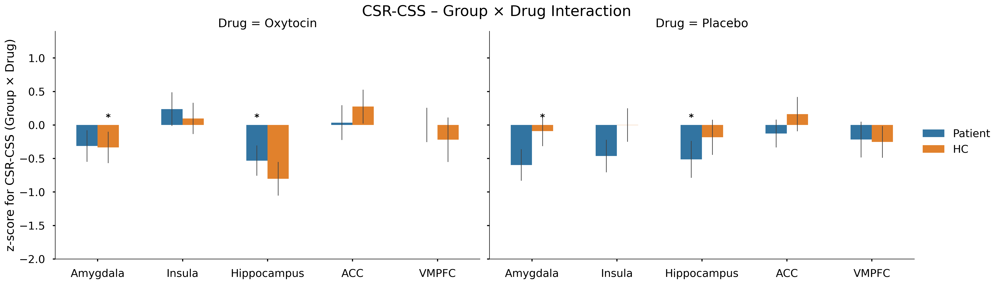


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.3010      
Insula              0.2216      
Hippocampus         0.2193      
ACC                 0.8769      
VMPFC               0.7751      
-----------------------------------


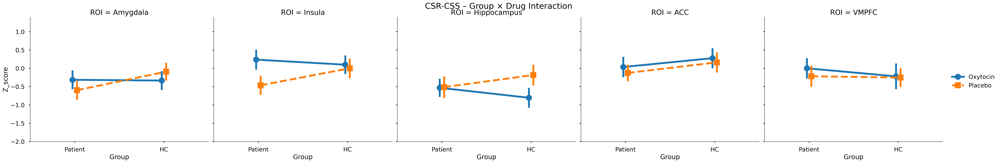


===== Group × Drug interaction: CSR-CS- =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.382     0.82    95    0.412      
Insula          Group[T.HC]:Drug[T.Placebo]                             0.194     0.34    95    0.736      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                             0.378     0.63    95    0.528      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.310     0.53    95    0.599      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.451     0.72    95    0.470      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


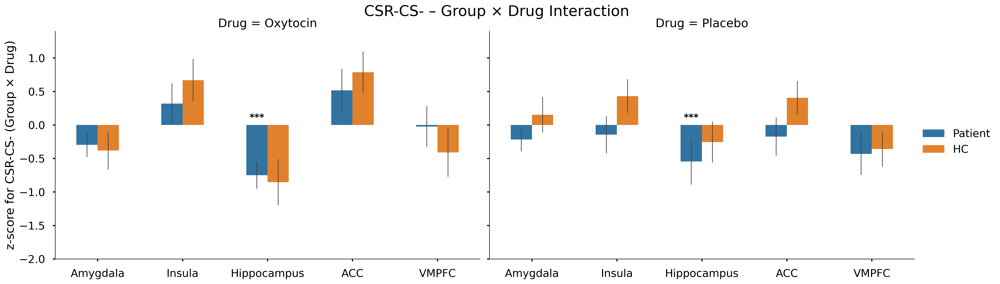


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.4115      
Insula              0.7361      
Hippocampus         0.5285      
ACC                 0.5987      
VMPFC               0.4704      
-----------------------------------


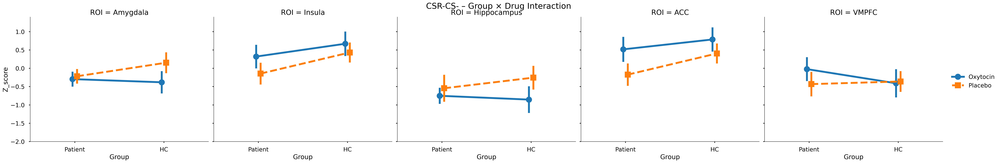


===== Group × Drug interaction: CSS-CS- =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                            -0.156    -0.36    95    0.719      
Insula          Group[T.HC]:Drug[T.Placebo]                            -0.453    -0.81    95    0.419      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                            -0.316    -0.66    95    0.510      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.212     0.38    95    0.702      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.258     0.46    95    0.643      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


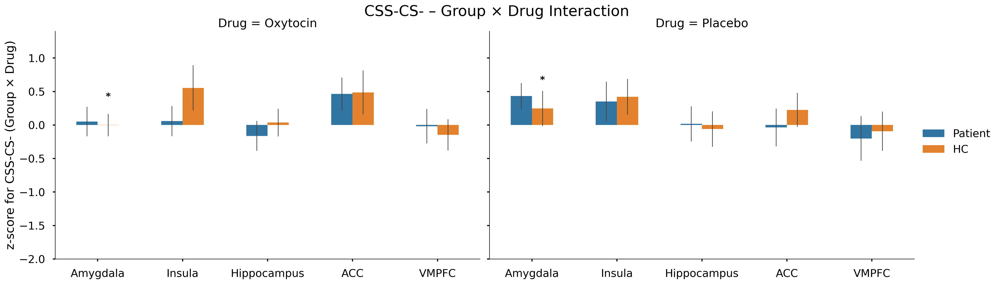


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.7194      
Insula              0.4191      
Hippocampus         0.5105      
ACC                 0.7017      
VMPFC               0.6430      
-----------------------------------


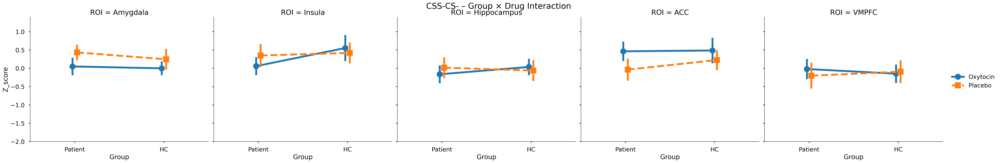


===== Group × Drug interaction: CSR-fix =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.342     0.68    95    0.496      
Insula          Group[T.HC]:Drug[T.Placebo]                             0.300     0.62    95    0.537      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                             0.312     0.55    95    0.586      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.613     1.03    95    0.304      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.912     1.49    95    0.140      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


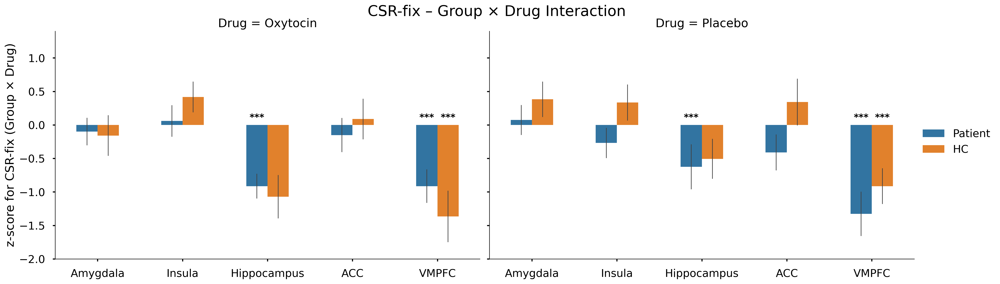


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.4964      
Insula              0.5365      
Hippocampus         0.5856      
ACC                 0.3037      
VMPFC               0.1397      
-----------------------------------


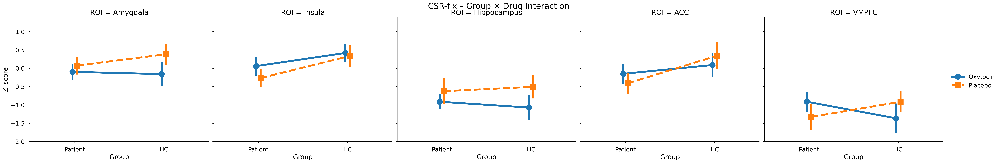


===== Group × Drug interaction: CSS-fix =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                            -0.317    -0.70    95    0.487      
Insula          Group[T.HC]:Drug[T.Placebo]                            -0.506    -1.01    95    0.316      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                            -0.549    -1.18    95    0.241      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.489     0.92    95    0.360      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.669     1.20    95    0.235      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


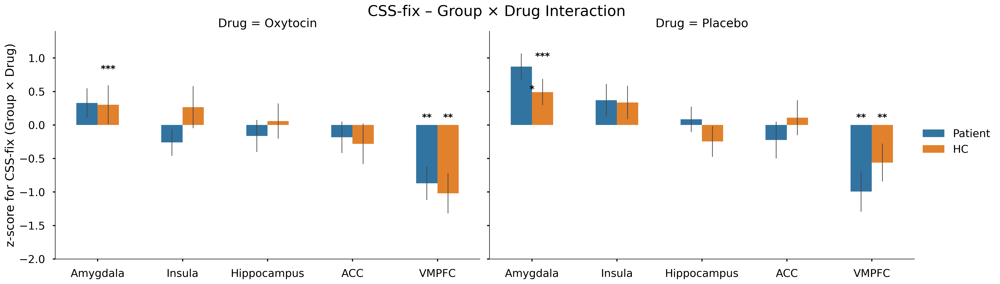


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.4867      
Insula              0.3161      
Hippocampus         0.2413      
ACC                 0.3599      
VMPFC               0.2351      
-----------------------------------


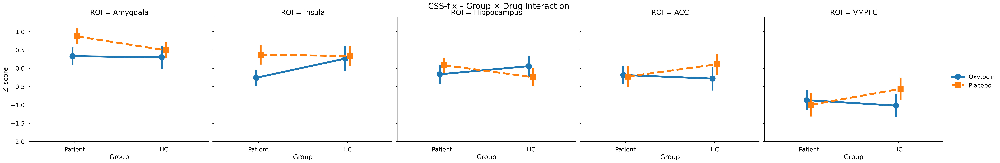


===== Group × Drug interaction: CSminus-fix =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                            -0.158    -0.33    95    0.739      
Insula          Group[T.HC]:Drug[T.Placebo]                             0.074     0.12    95    0.902      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                            -0.196    -0.35    95    0.725      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.241     0.42    95    0.675      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.352     0.58    95    0.563      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Dr

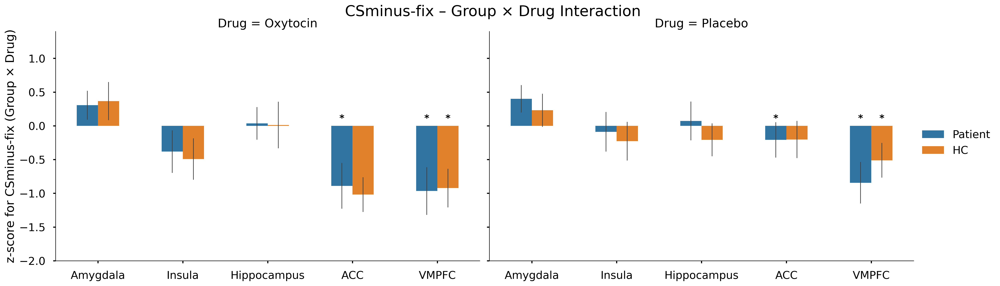


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.7389      
Insula              0.9022      
Hippocampus         0.7248      
ACC                 0.6748      
VMPFC               0.5634      
-----------------------------------


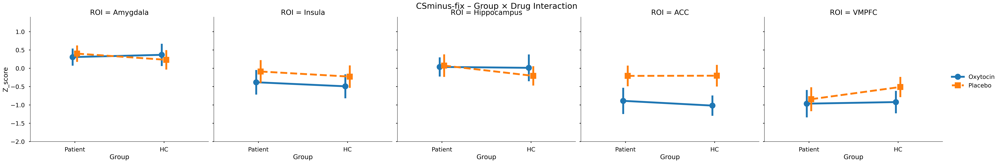


===== Group × Gender interaction: CSR-CSS =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.601     1.30    95    0.198      
Insula          Group[T.HC]:Gender[T.Female]                            0.094     0.19    95    0.853      
Hippocampus     Group[T.HC]:Gender[T.Female]                            1.038     2.03    95    0.045     *
ACC             Group[T.HC]:Gender[T.Female]                           -0.212    -0.42    95    0.675      
VMPFC           Group[T.HC]:Gender[T.Female]                           -0.058    -0.10    95    0.917      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

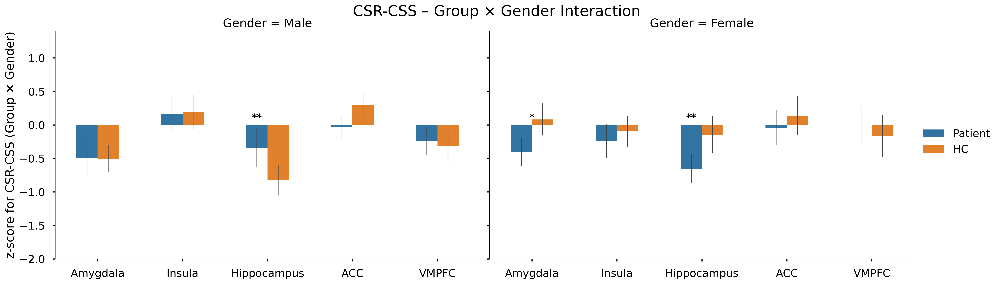


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.1977      
Insula              0.8530      
Hippocampus         0.0449     *
ACC                 0.6750      
VMPFC               0.9170      
-----------------------------------


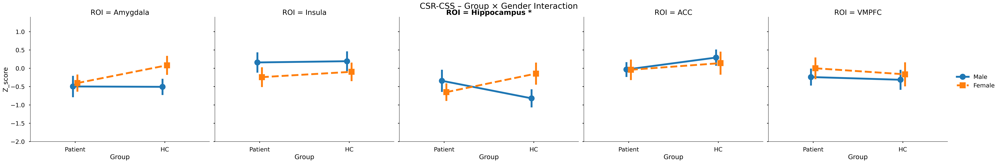


===== Group × Gender interaction: CSR-CS- =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.581     1.24    95    0.217      
Insula          Group[T.HC]:Gender[T.Female]                           -0.582    -0.99    95    0.325      
Hippocampus     Group[T.HC]:Gender[T.Female]                            1.087     1.80    95    0.076      
ACC             Group[T.HC]:Gender[T.Female]                           -0.355    -0.59    95    0.560      
VMPFC           Group[T.HC]:Gender[T.Female]                            0.307     0.48    95    0.631      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

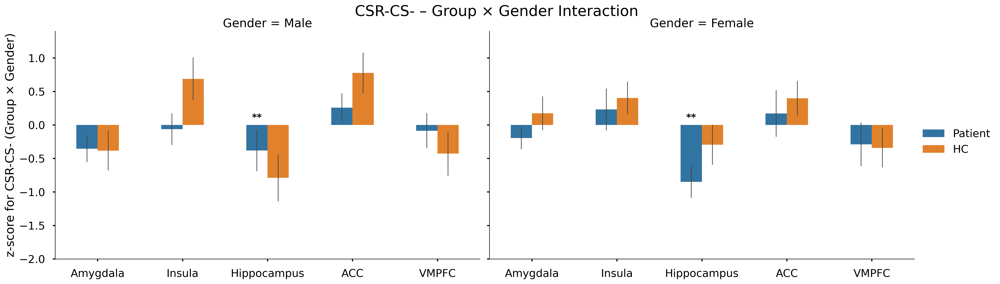


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2167      
Insula              0.3247      
Hippocampus         0.0756      
ACC                 0.5596      
VMPFC               0.6307      
-----------------------------------


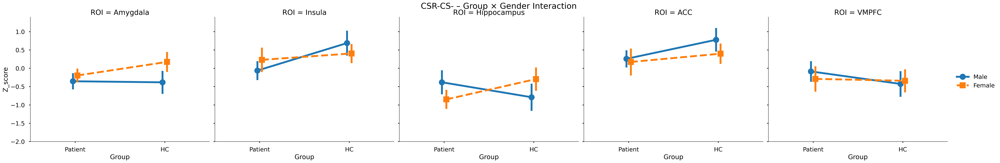


===== Group × Gender interaction: CSS-CS- =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                           -0.077    -0.17    95    0.863      
Insula          Group[T.HC]:Gender[T.Female]                           -0.656    -1.17    95    0.247      
Hippocampus     Group[T.HC]:Gender[T.Female]                           -0.055    -0.11    95    0.910      
ACC             Group[T.HC]:Gender[T.Female]                           -0.109    -0.19    95    0.848      
VMPFC           Group[T.HC]:Gender[T.Female]                            0.378     0.67    95    0.504      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

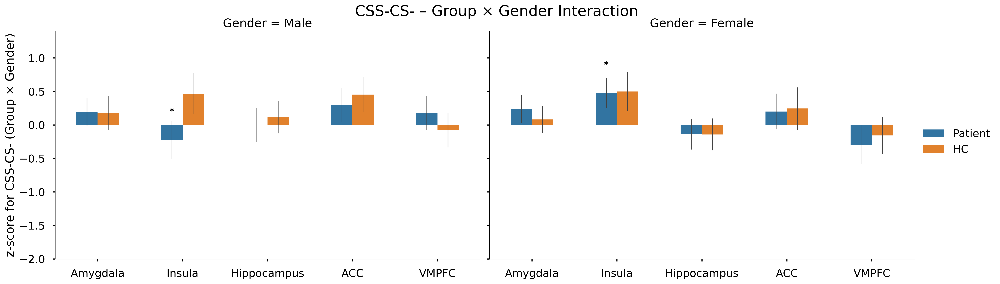


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.8632      
Insula              0.2468      
Hippocampus         0.9098      
ACC                 0.8484      
VMPFC               0.5039      
-----------------------------------


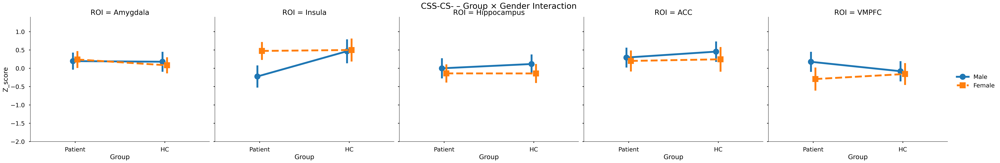


===== Group × Gender interaction: CSR-fix =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.877     1.76    95    0.081      
Insula          Group[T.HC]:Gender[T.Female]                           -0.161    -0.33    95    0.745      
Hippocampus     Group[T.HC]:Gender[T.Female]                            1.155     2.01    95    0.047     *
ACC             Group[T.HC]:Gender[T.Female]                           -0.414    -0.70    95    0.488      
VMPFC           Group[T.HC]:Gender[T.Female]                            0.305     0.48    95    0.630      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

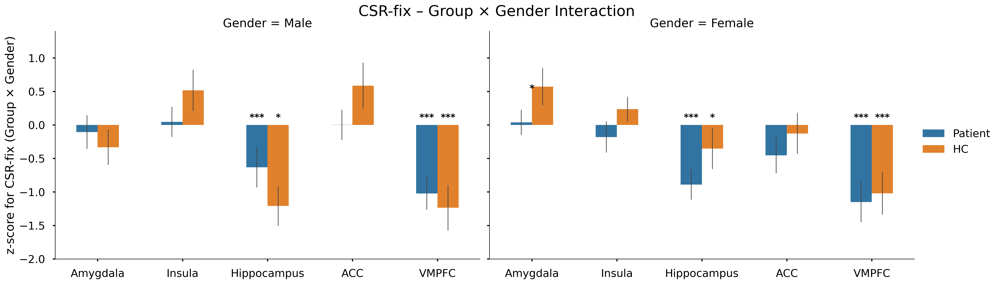


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.0809      
Insula              0.7450      
Hippocampus         0.0469     *
ACC                 0.4884      
VMPFC               0.6305      
-----------------------------------


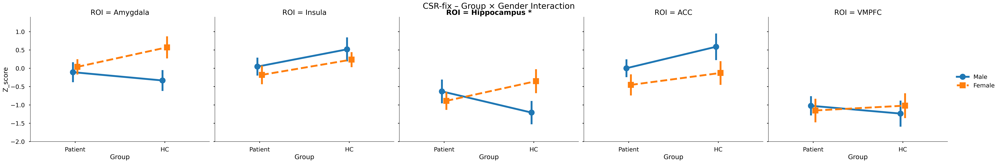


===== Group × Gender interaction: CSS-fix =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.037     0.08    95    0.937      
Insula          Group[T.HC]:Gender[T.Female]                           -0.273    -0.53    95    0.599      
Hippocampus     Group[T.HC]:Gender[T.Female]                           -0.271    -0.57    95    0.572      
ACC             Group[T.HC]:Gender[T.Female]                           -0.105    -0.19    95    0.846      
VMPFC           Group[T.HC]:Gender[T.Female]                            0.383     0.67    95    0.507      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

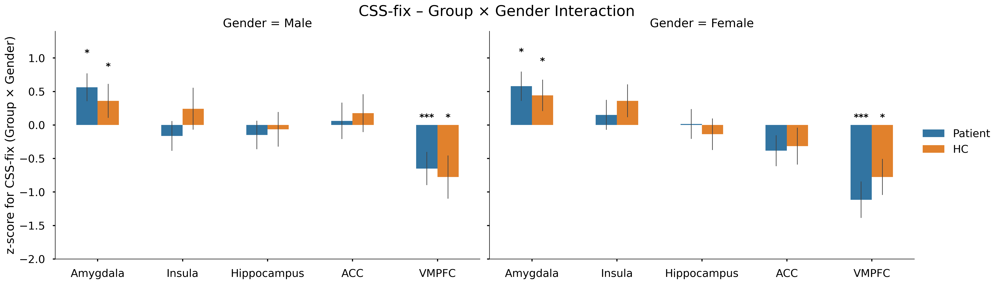


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.9370      
Insula              0.5994      
Hippocampus         0.5717      
ACC                 0.8460      
VMPFC               0.5071      
-----------------------------------


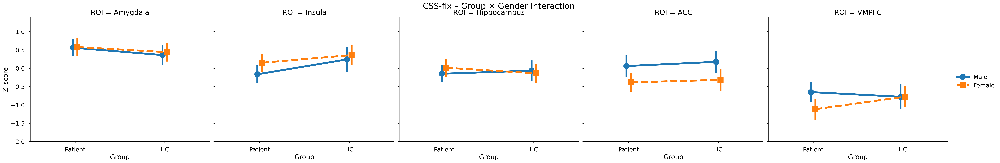


===== Group × Gender interaction: CSminus-fix =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.148     0.31    95    0.759      
Insula          Group[T.HC]:Gender[T.Female]                            0.638     1.05    95    0.297      
Hippocampus     Group[T.HC]:Gender[T.Female]                           -0.250    -0.45    95    0.657      
ACC             Group[T.HC]:Gender[T.Female]                            0.053     0.09    95    0.931      
VMPFC           Group[T.HC]:Gender[T.Female]                           -0.123    -0.20    95    0.844      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group 

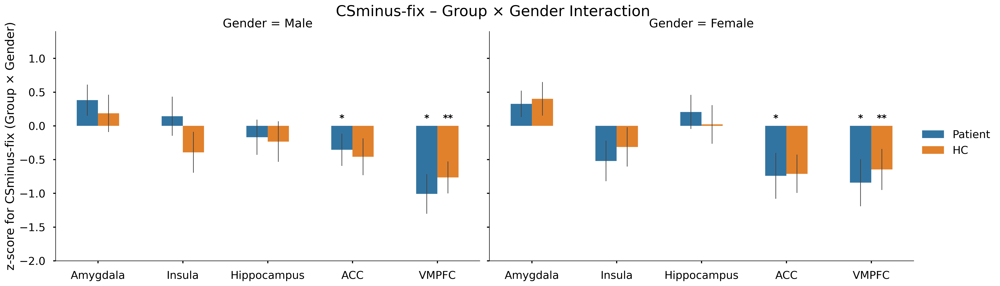


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.7591      
Insula              0.2971      
Hippocampus         0.6573      
ACC                 0.9306      
VMPFC               0.8444      
-----------------------------------


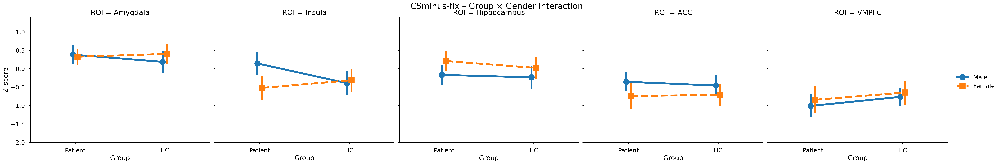


===== Drug × Gender interaction: CSR-CSS =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        0.091     0.19    95    0.846      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.044    -0.09    95    0.929      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -0.037    -0.07    95    0.942      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.146    -0.29    95    0.772      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.028    -0.05    95    0.959      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

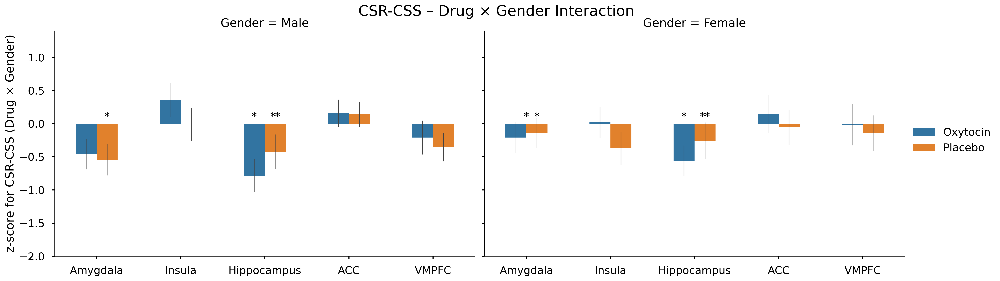


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.8458      
Insula              0.9293      
Hippocampus         0.9423      
ACC                 0.7718      
VMPFC               0.9593      
-----------------------------------


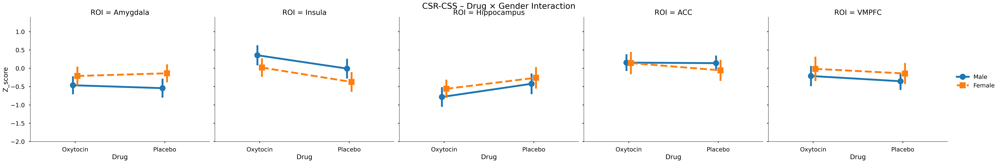


===== Drug × Gender interaction: CSR-CS- =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                       -0.305    -0.66    95    0.513      
Insula          Drug[T.Placebo]:Gender[T.Female]                        0.361     0.62    95    0.540      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -0.596    -0.99    95    0.324      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.336    -0.56    95    0.574      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.975    -1.57    95    0.120      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

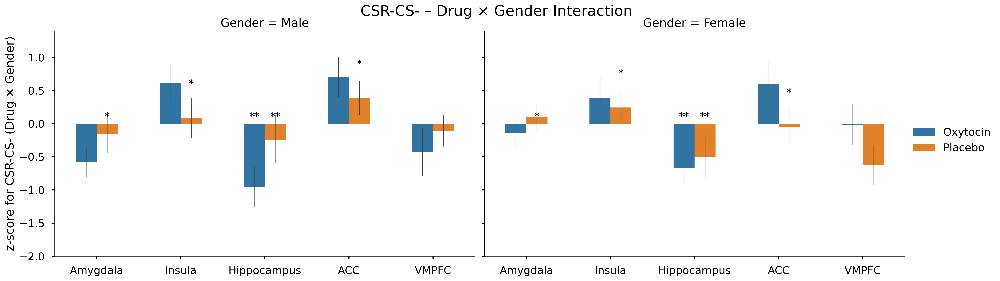


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.5130      
Insula              0.5400      
Hippocampus         0.3238      
ACC                 0.5743      
VMPFC               0.1204      
-----------------------------------


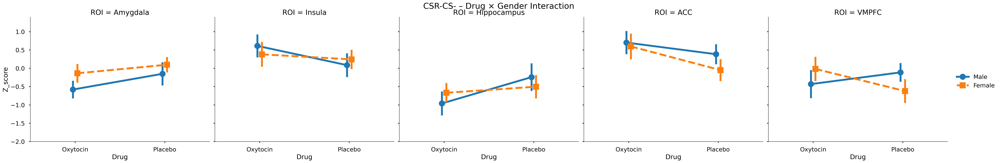


===== Drug × Gender interaction: CSS-CS- =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                       -0.376    -0.86    95    0.392      
Insula          Drug[T.Placebo]:Gender[T.Female]                        0.403     0.72    95    0.476      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -0.528    -1.10    95    0.273      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.156    -0.28    95    0.779      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.916    -1.66    95    0.099      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

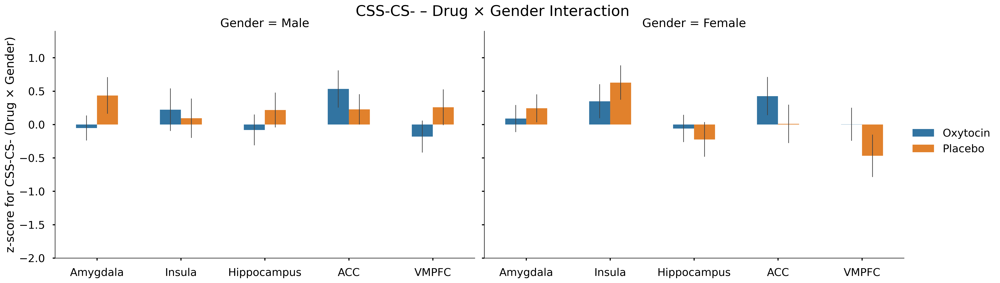


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.3922      
Insula              0.4759      
Hippocampus         0.2729      
ACC                 0.7793      
VMPFC               0.0995      
-----------------------------------


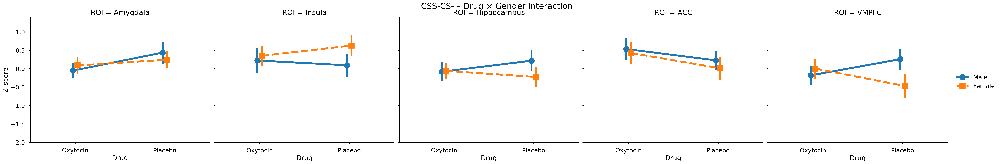


===== Drug × Gender interaction: CSR-fix =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                       -0.081    -0.16    95    0.870      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.086    -0.17    95    0.862      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -0.294    -0.51    95    0.608      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.487    -0.82    95    0.414      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.605    -0.97    95    0.333      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

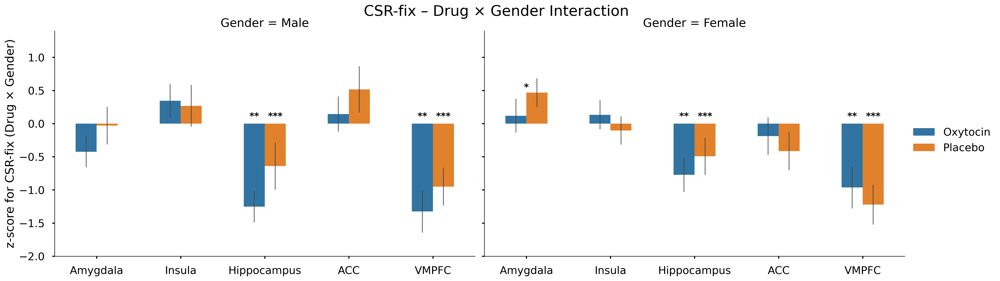


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.8701      
Insula              0.8617      
Hippocampus         0.6084      
ACC                 0.4144      
VMPFC               0.3330      
-----------------------------------


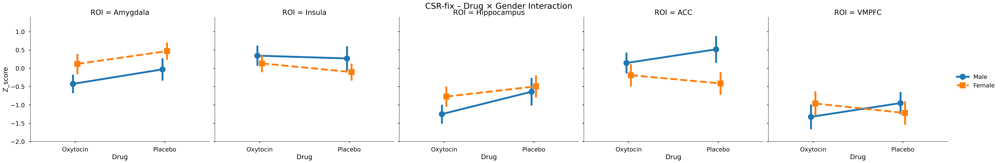


===== Drug × Gender interaction: CSS-fix =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                       -0.199    -0.43    95    0.667      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.026    -0.05    95    0.960      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -0.236    -0.50    95    0.619      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.283    -0.53    95    0.595      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.550    -0.97    95    0.333      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

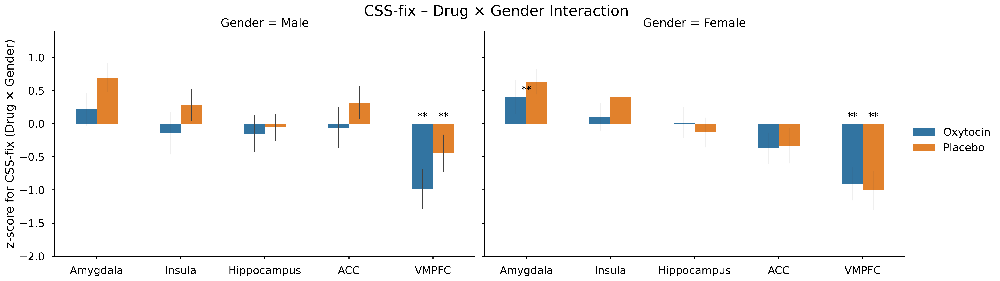


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.6673      
Insula              0.9600      
Hippocampus         0.6187      
ACC                 0.5948      
VMPFC               0.3328      
-----------------------------------


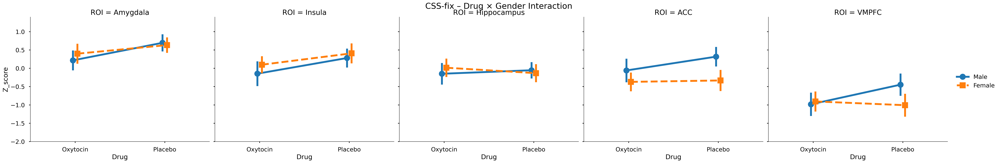


===== Drug × Gender interaction: CSminus-fix =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        0.318     0.67    95    0.505      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.612    -1.02    95    0.308      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                        0.499     0.90    95    0.370      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.066    -0.11    95    0.909      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                        0.694     1.14    95    0.258      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × G

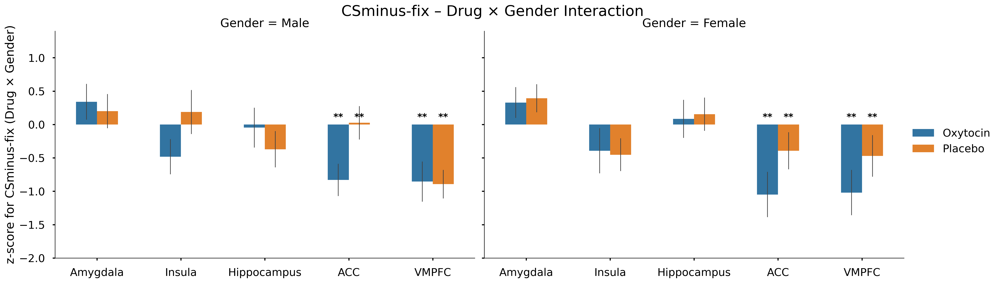


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.5048      
Insula              0.3082      
Hippocampus         0.3697      
ACC                 0.9089      
VMPFC               0.2578      
-----------------------------------


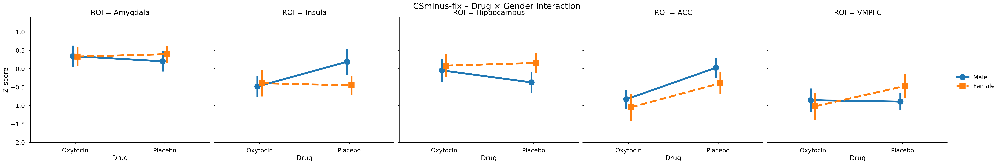

In [33]:
interaction_terms = get_matching_model_terms(model, "two_way")

for term in interaction_terms:
    var1, var2 = extract_factors_from_term(term)
    for contrast in contrast_list:
        print(f"\n===== {var1} × {var2} interaction: {contrast} =====")
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

        g = sns.catplot(
            x='ROI', y='Z_score', hue=var1, col=var2,
            order=ROI_list,
            kind='bar', errorbar='se',
            height=6, aspect=1.6, width=0.5,
            err_kws={'linewidth': 1},
            data=df
        )

        for ax in g.axes.flat:
            add_sig_stars(ax, df, ROI_list, term)

        g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/{contrast}_{var1}_{var2}_interaction_sig.png', bbox_inches='tight')
        plt.show()

        #line plots
        g = sns.catplot(
            data=df,
            x=var1, y='Z_score', hue=var2,
            col='ROI',
            kind='point',         # line plot (mean + SE)
            errorbar='se',        # ✅ correct for seaborn ≥0.12
            dodge=True,
            markers=['o', 's'],
            linestyles=['-', '--'],
            height=6, aspect=1.2
        )
        add_sig_stars_lineplot_interaction(
            g.axes, df, ROI_list, term
        )
        #g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/line_{contrast}_{var1}_{var2}_interaction_sig.png', bbox_inches='tight')
        plt.show()


===== Group × Drug  × Gender interaction: CSR-CSS =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.803    -0.87    91    0.385      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.443    -0.45    91    0.656      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.279    -0.28    91    0.783      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.051     0.05    91    0.960      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.539     0.49    91    0.628      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

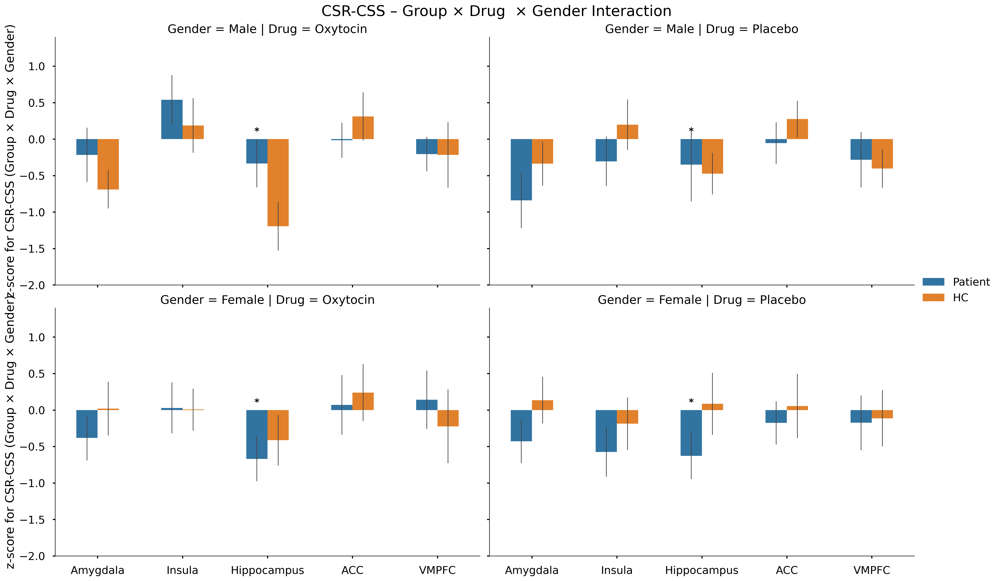


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.3852      
Insula              0.6558      
Hippocampus         0.7830      
ACC                 0.9598      
VMPFC               0.6284      
-----------------------------------


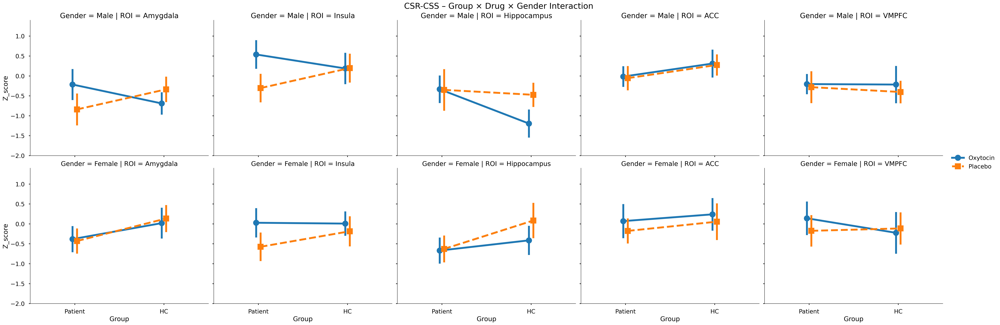


===== Group × Drug  × Gender interaction: CSR-CS- =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.075    -0.08    91    0.935      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.649     1.43    91    0.156      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.661     0.55    91    0.581      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.609     1.36    91    0.178      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.928     1.56    91    0.123      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

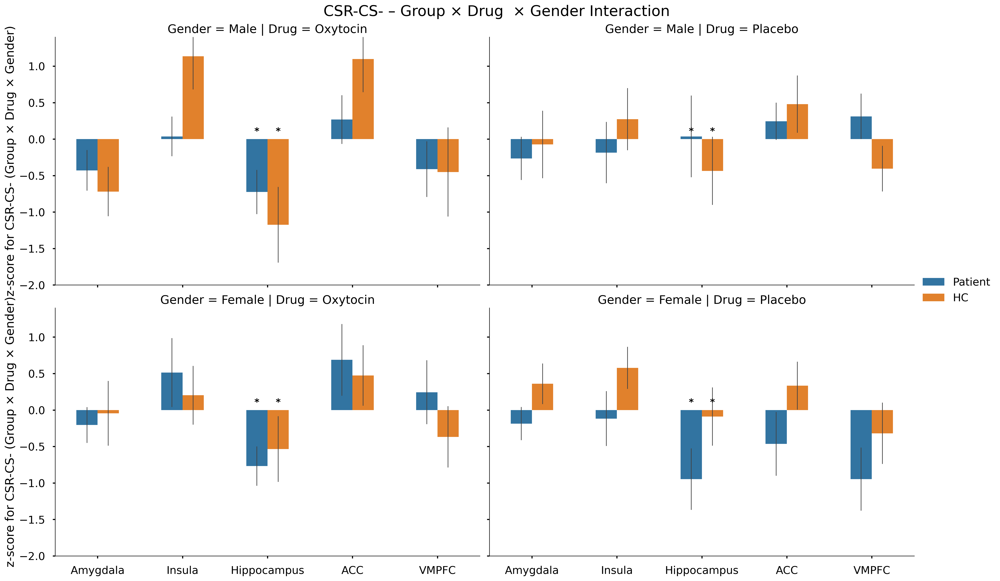


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.9354      
Insula              0.1562      
Hippocampus         0.5806      
ACC                 0.1776      
VMPFC               0.1231      
-----------------------------------


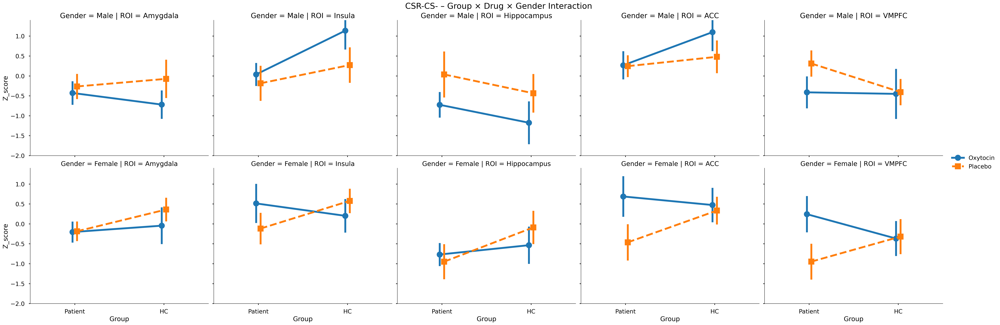


===== Group × Drug  × Gender interaction: CSS-CS- =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.826     0.94    91    0.351      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            2.088     1.90    91    0.061      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.014     1.06    91    0.294      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.515     1.36    91    0.177      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.337     1.21    91    0.229      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

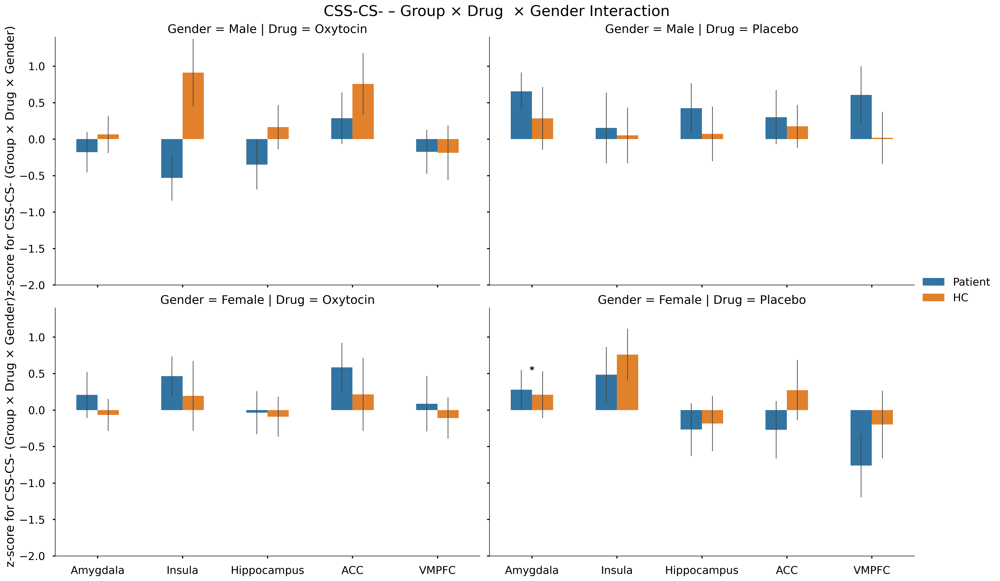


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.3507      
Insula              0.0609      
Hippocampus         0.2942      
ACC                 0.1771      
VMPFC               0.2287      
-----------------------------------


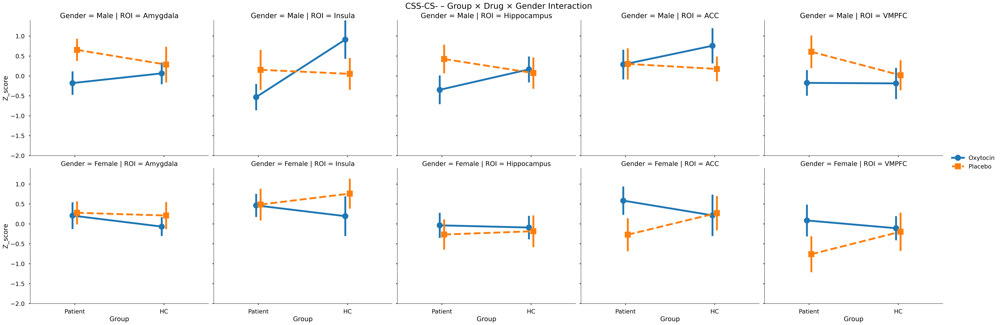


===== Group × Drug  × Gender interaction: CSR-fix =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.461    -1.50    91    0.137      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.338    -0.34    91    0.732      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.688     0.61    91    0.544      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.779     0.66    91    0.511      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.978     1.61    91    0.111      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

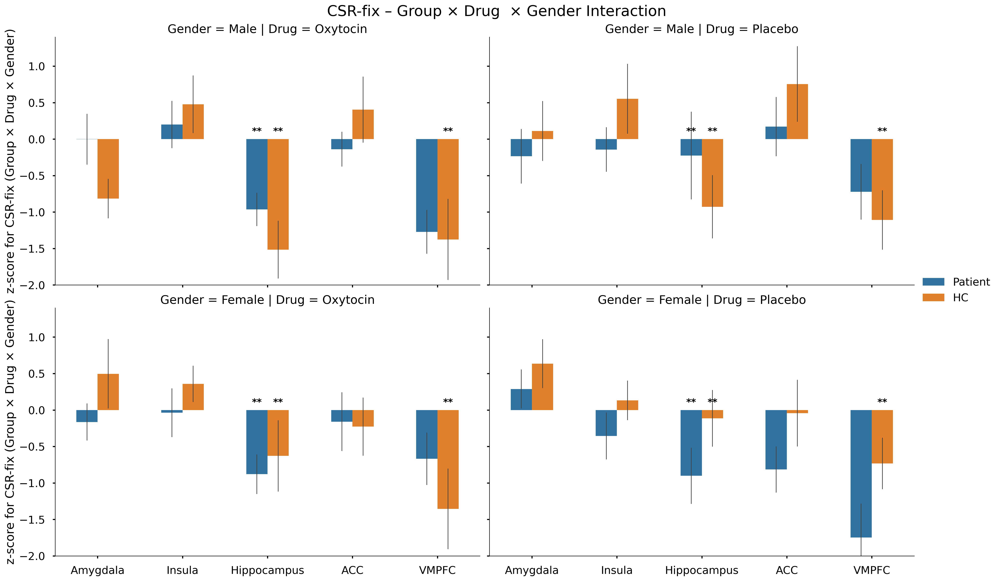


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.1375      
Insula              0.7321      
Hippocampus         0.5443      
ACC                 0.5107      
VMPFC               0.1113      
-----------------------------------


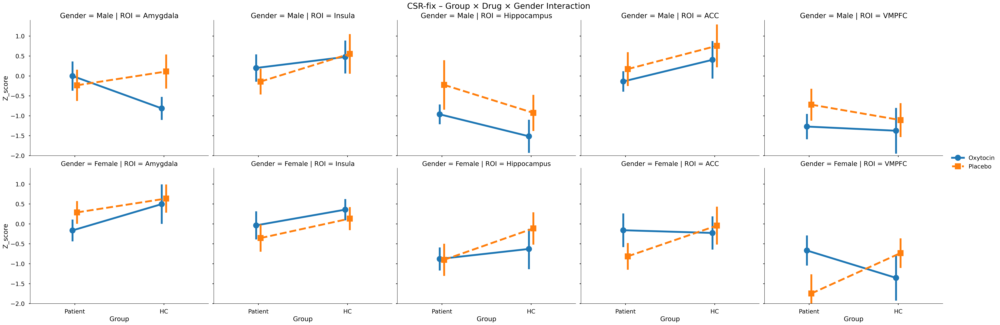


===== Group × Drug  × Gender interaction: CSS-fix =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.337    -0.36    91    0.717      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.234     0.23    91    0.820      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.077     1.14    91    0.256      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.636     0.60    91    0.553      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.228     1.09    91    0.279      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

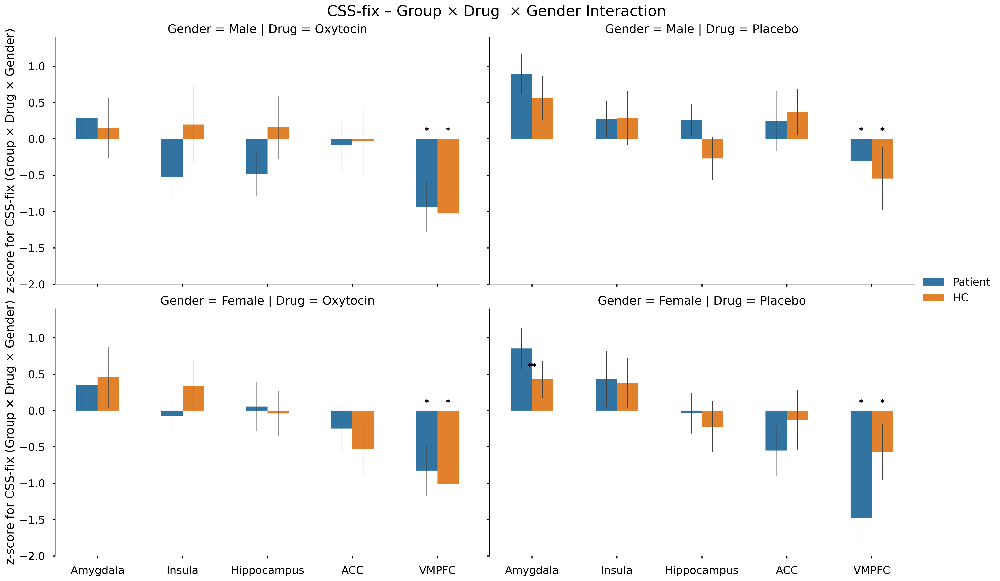


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.7172      
Insula              0.8195      
Hippocampus         0.2563      
ACC                 0.5526      
VMPFC               0.2793      
-----------------------------------


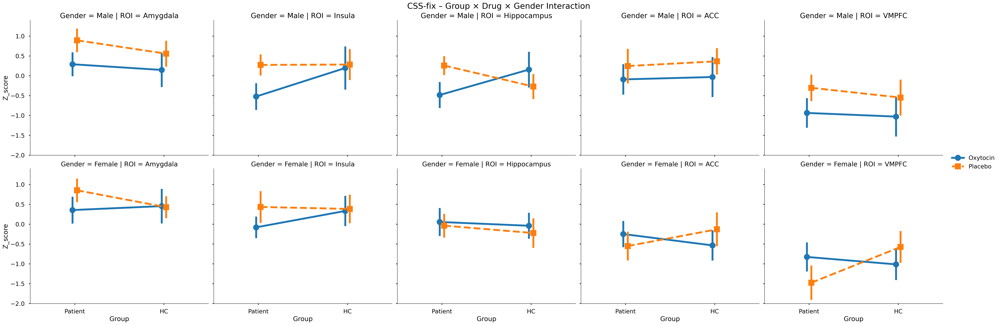


===== Group × Drug  × Gender interaction: CSminus-fix =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.589    -1.67    91    0.098      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -2.716    -2.32    91    0.022     *
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.271    -0.24    91    0.809      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.398    -1.21    91    0.229      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.560    -0.46    91    0.650      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTIO

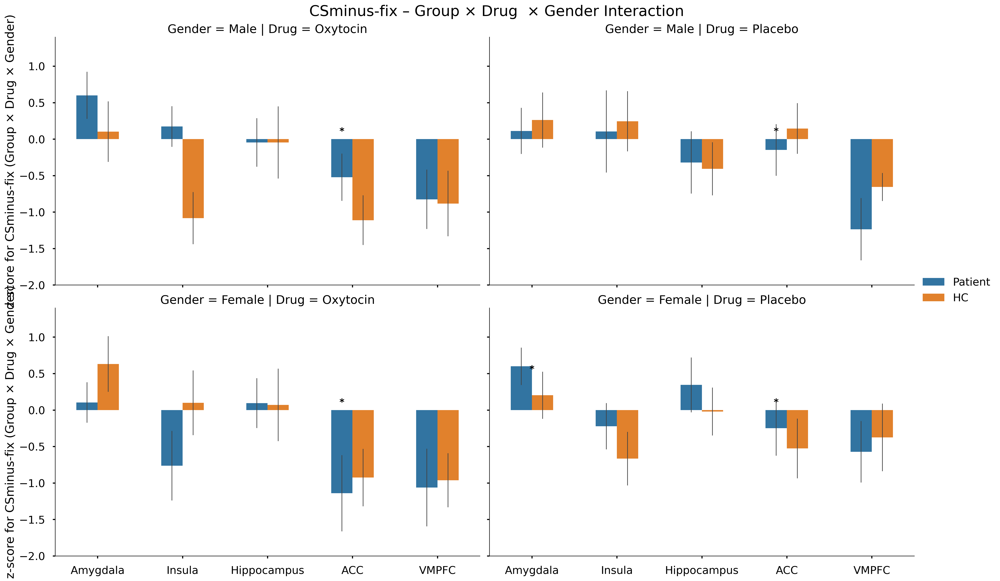


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.0975      
Insula              0.0223     *
Hippocampus         0.8092      
ACC                 0.2291      
VMPFC               0.6499      
-----------------------------------


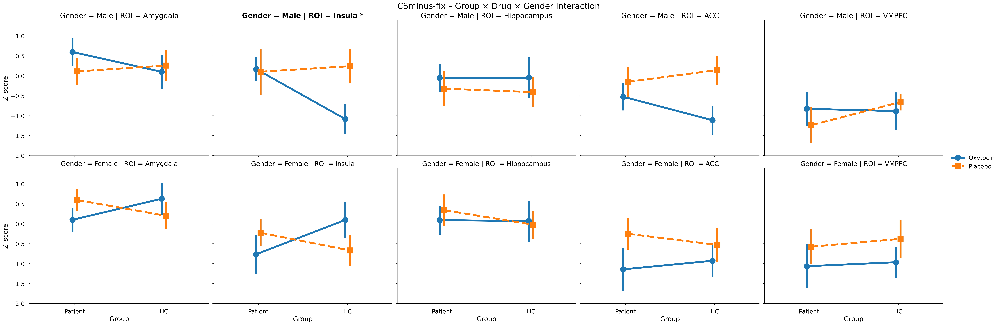

In [34]:
interaction_terms = get_matching_model_terms(model, "three_way")

for term in interaction_terms:
    var1, var2, var3 = extract_factors_from_term(term)
    for contrast in contrast_list:
        print(f"\n===== {var1} × {var2}  × {var3} interaction: {contrast} =====")
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

        g = sns.catplot(
            x='ROI', y='Z_score', hue=var1, col=var2, row=var3,
            order=ROI_list,
            kind='bar', errorbar='se',
            height=6, aspect=1.6, width=0.5,
            err_kws={'linewidth': 1},
            data=df
        )

        for ax in g.axes.flat:
            add_sig_stars(ax, df, ROI_list, term)

        g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2} × {var3})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2}  × {var3} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/{contrast}_{var1}_{var2}_{var3}_interaction_sig.png', bbox_inches='tight')
        plt.show()

        #line plots
        g = sns.catplot(
            data=df,
            x=var1, y='Z_score', hue=var2, row=var3,
            col='ROI',
            kind='point',         # line plot (mean + SE)
            errorbar='se',        # ✅ correct for seaborn ≥0.12
            dodge=True,
            markers=['o', 's'],
            linestyles=['-', '--'],
            height=6, aspect=1.2
        )
        add_sig_stars_lineplot_interaction(
            g.axes, df, ROI_list, term
        )
        #g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2} × {var3} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/line_{contrast}_{var1}_{var2}_{var3}_interaction_sig.png', bbox_inches='tight')
        plt.show()

In [35]:

formula = "Z_score ~ Group * Drug * Gender + guess"

for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Group * Drug * Gender + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.484    -1.02    91     0.3098      
Amygdala        Drug[T.Placebo]                                        -0.599    -1.17    91     0.2439      
Amygdala        Gender[T.Female]                                       -0.186    -0.42    91     0.6764      
Amygdala        guess[T.1.0]                                           -0.252    -0.98    91     0.3295      
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.906     1.32    91     0.1908      
Amygdala        Group[T.HC]:Gender[T.Female]                            0.980     1.50    91     0.1359      
Amygdala        Drug[T.Placebo]:Gender[T.Female]               

In [36]:

formula = "Z_score ~ Group * Drug + guess"

for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Group * Drug + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.016     0.05    95     0.9615      
Amygdala        Drug[T.Placebo]                                        -0.312    -0.95    95     0.3453      
Amygdala        guess[T.1.0]                                           -0.211    -0.86    95     0.3946      
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.479     1.04    95     0.3010      
Insula          Group[T.HC]                                            -0.140    -0.41    95     0.6847      
Insula          Drug[T.Placebo]                                        -0.700    -2.00    95     0.0481     *
Insula          guess[T.1.0]                                            

In [37]:

formula = "Z_score ~ Group * Gender + guess"
for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Group * Gender + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.058    -0.17    95     0.8656      
Amygdala        Gender[T.Female]                                        0.024     0.07    95     0.9415      
Amygdala        guess[T.1.0]                                           -0.267    -1.12    95     0.2653      
Amygdala        Group[T.HC]:Gender[T.Female]                            0.601     1.30    95     0.1977      
Insula          Group[T.HC]                                             0.042     0.11    95     0.9110      
Insula          Gender[T.Female]                                       -0.389    -1.08    95     0.2847      
Insula          guess[T.1.0]                                          

In [38]:

formula = "Z_score ~ Drug * Gender + guess"

for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase2')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Drug * Gender + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.093    -0.27    95     0.7846      
Amygdala        Gender[T.Female]                                        0.273     0.85    95     0.3990      
Amygdala        guess[T.1.0]                                           -0.195    -0.79    95     0.4335      
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        0.091     0.19    95     0.8458      
Insula          Drug[T.Placebo]                                        -0.367    -1.02    95     0.3121      
Insula          Gender[T.Female]                                       -0.331    -0.97    95     0.3343      
Insula          guess[T.1.0]                                           